In [ ]:
import pandas as pd

In [ ]:
file = "/content/youtube-comments_video1.csv"
df = pd.read_csv(file)
df.head()

,publishedAt,authorDisplayName,textDisplay,likeCount
0,2024-06-20T09:33:54Z,@VICE,WATCH NEXT: A new VICE documentary investigate...,68.0
1,2024-06-22T11:25:46Z,@antonykanithkar,"can i ask you , the lady said , noone will no ...",8.0
2,2024-06-23T08:22:00Z,@freekickindiansportschanne9284,​@JaiMuhammad-hy1jtx<br>Q ❤,0.0
3,2024-06-29T20:57:49Z,@3five771,"@JaiMuhammad-hy1jt <a href=""https://www.youtub...",0.0
4,2024-06-29T20:57:58Z,@3five771,"@JaiMuhammad-hy1jt <a href=""https://www.youtub...",0.0


In [ ]:
df[['publishedAt', 'authorDisplayName',	'textDisplay']].head()

,publishedAt,authorDisplayName,textDisplay
0,2024-06-20T09:33:54Z,@VICE,WATCH NEXT: A new VICE documentary investigate...
1,2024-06-22T11:25:46Z,@antonykanithkar,"can i ask you , the lady said , noone will no ..."
2,2024-06-23T08:22:00Z,@freekickindiansportschanne9284,​@JaiMuhammad-hy1jtx<br>Q ❤
3,2024-06-29T20:57:49Z,@3five771,"@JaiMuhammad-hy1jt <a href=""https://www.youtub..."
4,2024-06-29T20:57:58Z,@3five771,"@JaiMuhammad-hy1jt <a href=""https://www.youtub..."


In [ ]:
new_df = df[['publishedAt', 'authorDisplayName',	'textDisplay']]
sorted_df = new_df.sort_values(by='publishedAt', ascending=False)
sorted_df.head()

,publishedAt,authorDisplayName,textDisplay
4326,<br>TAKE THAT VIDEO DOWN!!!!!!!!!!!!!!,0,NaN
4325,<br>,NaN,NaN
6,2024-10-04T06:11:20Z,@MikeyzMovies,I&#39;m watching the this faded
7,2024-10-04T02:20:56Z,@BlazinCaucasian420,American tribes sell weed to survive too.
8,2024-10-03T11:05:00Z,@DereckVankirk,They need chronic seeds and me showing them ho...


In [ ]:
my_df = sorted_df[['publishedAt', 'authorDisplayName',	'textDisplay']]
my_df = my_df[['textDisplay']]
my_df.head()

,textDisplay
4326,NaN
4325,NaN
6,I&#39;m watching the this faded
7,American tribes sell weed to survive too.
8,They need chronic seeds and me showing them ho...


In [ ]:
my_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5793 entries, 4326 to 5792
Data columns (total 1 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   textDisplay  5791 non-null   object
dtypes: object(1)
memory usage: 90.5+ KB


In [ ]:
my_df.isna()

,textDisplay
4326,True
4325,True
6,False
7,False
8,False
...,...
5777,False
5783,False
5785,False
5791,False


In [ ]:
my_df.isna().any()

,0
textDisplay,True


In [ ]:
my_df.describe()

,textDisplay
count,5791
unique,5727
top,❤
freq,10


In [ ]:
my_df.isnull().sum()

,0
textDisplay,2


In [ ]:
my_df.dropna(subset=['textDisplay'], inplace = True)

In [ ]:
my_df.isnull().sum()

,0
textDisplay,0


In [ ]:
my_df.head(50)

,textDisplay
6,I&#39;m watching the this faded
7,American tribes sell weed to survive too.
8,They need chronic seeds and me showing them ho...
9,Who else watching this while high asf
10,Rolls his joint with lined paper lol
11,Where my stoners at lets fly to congo 🤌🏾
12,Song name from the beginning of the video?
13,"Illegal weed , the Europeans have made their b..."
14,How can i send gift and make sure these people...
15,Elders got him to chill when they made him rea...


In [ ]:
my_df.to_csv('text2.csv', index=False)

# Text Pre-Processing

In [ ]:
df = pd.read_csv('/content/text2.csv')
df.head(50)

,textDisplay
0,I&#39;m watching the this faded
1,American tribes sell weed to survive too.
2,They need chronic seeds and me showing them ho...
3,Who else watching this while high asf
4,Rolls his joint with lined paper lol
5,Where my stoners at lets fly to congo 🤌🏾
6,Song name from the beginning of the video?
7,"Illegal weed , the Europeans have made their b..."
8,How can i send gift and make sure these people...
9,Elders got him to chill when they made him rea...


## case folding

In [ ]:
import re
def clean_text(df, text_field, new_text_field_name):
  my_df[new_text_field_name] = my_df[text_field].str.lower()
  my_df[new_text_field_name] = my_df[new_text_field_name].apply(lambda elem: re.sub(r"(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)|^rt|http.+?", "", elem))

  my_df[new_text_field_name] = my_df[new_text_field_name].apply(lambda elem: re.sub(r"\d+", "", elem))
  return my_df

In [ ]:
my_df['text_clean'] = my_df['textDisplay'].str.lower()
my_df['text_clean']
data_clean = clean_text(my_df, 'textDisplay', 'text_clean')
data_clean.head(10)

,textDisplay,text_clean
6,I&#39;m watching the this faded,im watching the this faded
7,American tribes sell weed to survive too.,american tribes sell weed to survive too
8,They need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...
9,Who else watching this while high asf,who else watching this while high asf
10,Rolls his joint with lined paper lol,rolls his joint with lined paper lol
11,Where my stoners at lets fly to congo 🤌🏾,where my stoners at lets fly to congo
12,Song name from the beginning of the video?,song name from the beginning of the video
13,"Illegal weed , the Europeans have made their b...",illegal weed the europeans have made their be...
14,How can i send gift and make sure these people...,how can i send gift and make sure these people...
15,Elders got him to chill when they made him rea...,elders got him to chill when they made him rea...


##translate

In [ ]:
pip install googletrans==4.0.0-rc1

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.1/55.1 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.0/65.0 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 47.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.6/53.6 kB 4.9 MB/s eta 0:00:00
  Created wheel for googletrans: filename=googletrans-4.0.0rc1-py3-none-any.whl size=17397 sha256=5dc9ac420ed4d7f5d07da0957a4ad4e6702a8e29a7dc863d13d30a1403688b2e
  Stored in directory: /root/.cache/pip/wheels/c0/59/9f/7372f0cf70160fe61b528532e1a7c8498c4becd6bcffb022de
Successfully built googletrans
  Attempting uninstall: h11
    Found existing installation: h11 0.14.0
    Uninstalling h11-0.14.0:
      Suc

In [ ]:
import pandas as pd
from googletrans import Translator

# Inisialisasi translator
translator = Translator()

# Pilih kolom yang ingin diterjemahkan
column_to_translate =  ['textDisplay']  # Ganti dengan nama kolom Anda

# Fungsi untuk menerjemahkan teks
def translate_text(text):
    try:
        translated = translator.translate(text, src='auto', dest='en')
        return translated.text
    except Exception as e:
        print(f"Error translating: {text} - {e}")
        return text

# Menerjemahkan data di kolom
df[column_to_translate] = df[column_to_translate].astype(str).apply(translate_text)
data_clean = clean_text(my_df, 'textDisplay', 'translate')
data_clean.head(10)

Error translating: 0                         I&#39;m watching the this faded
1               American tribes sell weed to survive too.
2       They need chronic seeds and me showing them ho...
3                   Who else watching this while high asf
4                    Rolls his joint with lined paper lol
                              ...                        
5786      Weed &gt; pills bring this show back please !!!
5787                                    Vice is awesome ❤
5788    It’s good to know we help poor people by smoki...
5789                                                 wooo
5790                                                First
Name: textDisplay, Length: 5791, dtype: object - Object of type Series is not JSON serializable


,textDisplay,text_clean,translate
6,I&#39;m watching the this faded,im watching the this faded,im watching the this faded
7,American tribes sell weed to survive too.,american tribes sell weed to survive too,american tribes sell weed to survive too
8,They need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...
9,Who else watching this while high asf,who else watching this while high asf,who else watching this while high asf
10,Rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls his joint with lined paper lol
11,Where my stoners at lets fly to congo 🤌🏾,where my stoners at lets fly to congo,where my stoners at lets fly to congo
12,Song name from the beginning of the video?,song name from the beginning of the video,song name from the beginning of the video
13,"Illegal weed , the Europeans have made their b...",illegal weed the europeans have made their be...,illegal weed the europeans have made their be...
14,How can i send gift and make sure these people...,how can i send gift and make sure these people...,how can i send gift and make sure these people...
15,Elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got him to chill when they made him rea...


## stop words removal

In [ ]:
import nltk.corpus
nltk.download('stopwords')

from nltk.corpus import stopwords
stop = stopwords.words('english')

data_clean['text_Stopword'] = data_clean['text_clean'].apply(lambda x:' '.join([word for word in x.split() if word not in (stop)]))
data_clean.head(50)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


,textDisplay,text_clean,translate,text_Stopword
6,I&#39;m watching the this faded,im watching the this faded,im watching the this faded,im watching faded
7,American tribes sell weed to survive too.,american tribes sell weed to survive too,american tribes sell weed to survive too,american tribes sell weed survive
8,They need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,need chronic seeds showing grow
9,Who else watching this while high asf,who else watching this while high asf,who else watching this while high asf,else watching high asf
10,Rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls joint lined paper lol
11,Where my stoners at lets fly to congo 🤌🏾,where my stoners at lets fly to congo,where my stoners at lets fly to congo,stoners lets fly congo
12,Song name from the beginning of the video?,song name from the beginning of the video,song name from the beginning of the video,song name beginning video
13,"Illegal weed , the Europeans have made their b...",illegal weed the europeans have made their be...,illegal weed the europeans have made their be...,illegal weed europeans made beds lay brdown re...
14,How can i send gift and make sure these people...,how can i send gift and make sure these people...,how can i send gift and make sure these people...,send gift make sure people receive way help tr...
15,Elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got chill made realize ne vice crew cou...


In [ ]:
data_clean['text_Stopword'] = data_clean['text_Stopword'].fillna('')

data_clean['text_Stopword'] = data_clean['text_Stopword'].astype(str)

## tokenize

In [ ]:
import nltk
nltk.download('punkt_tab')
from nltk.tokenize import sent_tokenize, word_tokenize
data_clean['text_tokens'] = data_clean['text_Stopword'].apply(lambda x: word_tokenize(x))
data_clean.head()

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


,textDisplay,text_clean,translate,text_Stopword,text_tokens
6,I&#39;m watching the this faded,im watching the this faded,im watching the this faded,im watching faded,"[im, watching, faded]"
7,American tribes sell weed to survive too.,american tribes sell weed to survive too,american tribes sell weed to survive too,american tribes sell weed survive,"[american, tribes, sell, weed, survive]"
8,They need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,need chronic seeds showing grow,"[need, chronic, seeds, showing, grow]"
9,Who else watching this while high asf,who else watching this while high asf,who else watching this while high asf,else watching high asf,"[else, watching, high, asf]"
10,Rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls joint lined paper lol,"[rolls, joint, lined, paper, lol]"


## stemming

In [ ]:
import nltk
from nltk.stem import PorterStemmer
stemmer = PorterStemmer()
def stemmed_wrapper(term):
    return stemmer.stem(term)
term_dict = {}
hitung = 0
for document in data_clean['text_tokens']:
    for term in document:
        if term not in term_dict:
            term_dict[term] = ' '
print(len(term_dict))
print("------------------------")
for term in term_dict:
    term_dict[term] = stemmed_wrapper(term)
    hitung += 1
    print(hitung, ":", term, ":", term_dict[term])
print(term_dict)
print("------------------------")
def get_stemmed_term(document):
    return [term_dict[term] for term in document]
data_clean['text_stemmed'] = data_clean['text_tokens'].apply(lambda x: get_stemmed_term(x))
data_clean.head(20)

Output streaming akan dipotong hingga 5000 baris terakhir.
5283 : laughive : laughiv
5284 : documentarybrby : documentarybrbi
5285 : chopped : chop
5286 : cannibalized : cannib
5287 : quotit : quotit
5288 : eatquot : eatquot
5289 : snared : snare
5290 : sicret : sicret
5291 : kuz : kuz
5292 : hides : hide
5293 : sinsemila : sinsemila
5294 : bigger : bigger
5295 : seedless : seedless
5296 : seedsonly : seedsonli
5297 : sinsemilla : sinsemilla
5298 : hunts : hunt
5299 : fights : fight
5300 : finds : find
5301 : survivebrbrwestern : survivebrbrwestern
5302 : technological : technolog
5303 : advancement : advanc
5304 : purrr : purrr
5305 : aye : aye
5306 : candy : candi
5307 : inviting : invit
5308 : grandparents : grandpar
5309 : yearsbrim : yearsbrim
5310 : woulda : woulda
5311 : plate : plate
5312 : lemon : lemon
5313 : cherry : cherri
5314 : exchange : exchang
5315 : auntie : aunti
5316 : meatball : meatbal
5317 : badthe : badth
5318 : entire : entir
5319 : geostrategical : geostrateg


,textDisplay,text_clean,translate,text_Stopword,text_tokens,text_stemmed
6,I&#39;m watching the this faded,im watching the this faded,im watching the this faded,im watching faded,"[im, watching, faded]","[im, watch, fade]"
7,American tribes sell weed to survive too.,american tribes sell weed to survive too,american tribes sell weed to survive too,american tribes sell weed survive,"[american, tribes, sell, weed, survive]","[american, tribe, sell, weed, surviv]"
8,They need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,need chronic seeds showing grow,"[need, chronic, seeds, showing, grow]","[need, chronic, seed, show, grow]"
9,Who else watching this while high asf,who else watching this while high asf,who else watching this while high asf,else watching high asf,"[else, watching, high, asf]","[els, watch, high, asf]"
10,Rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls joint lined paper lol,"[rolls, joint, lined, paper, lol]","[roll, joint, line, paper, lol]"
11,Where my stoners at lets fly to congo 🤌🏾,where my stoners at lets fly to congo,where my stoners at lets fly to congo,stoners lets fly congo,"[stoners, lets, fly, congo]","[stoner, let, fli, congo]"
12,Song name from the beginning of the video?,song name from the beginning of the video,song name from the beginning of the video,song name beginning video,"[song, name, beginning, video]","[song, name, begin, video]"
13,"Illegal weed , the Europeans have made their b...",illegal weed the europeans have made their be...,illegal weed the europeans have made their be...,illegal weed europeans made beds lay brdown re...,"[illegal, weed, europeans, made, beds, lay, br...","[illeg, weed, european, made, bed, lay, brdown..."
14,How can i send gift and make sure these people...,how can i send gift and make sure these people...,how can i send gift and make sure these people...,send gift make sure people receive way help tr...,"[send, gift, make, sure, people, receive, way,...","[send, gift, make, sure, peopl, receiv, way, h..."
15,Elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got chill made realize ne vice crew cou...,"[elders, got, chill, made, realize, ne, vice, ...","[elder, got, chill, made, realiz, ne, vice, cr..."


In [ ]:
from wordcloud import WordCloud, STOPWORDS

cswr = set(STOPWORDS)
cswr.update(['plea', 'nust', 'leav', 'put', 'develop', 'first', 'ye', 'im', 'back', 'educ', 'left', 'powerti', 'kill', 'keep', 'peac','made','contin','let','amp','href','didnt','hand','new','call','noth','drc','fuck','lie','thank','nan','mean','end','build', 'create', 'mani', 'man', 'part', 'call','say','rule','happen','dont'])

def remove_cswr(word_list):
    return [word for word in word_list if word.lower() not in cswr]

data_clean['text_stemmed'] = data_clean['text_stemmed'].apply(remove_cswr)

In [ ]:
data_clean['text_stemmedSTR1'] = data_clean['text_stemmed'].apply(lambda x: ' '.join(x) if isinstance(x, list) else x)
data_clean.head(50)

,textDisplay,text_clean,translate,text_Stopword,text_tokens,text_stemmed,text_stemmedSTR1
6,I&#39;m watching the this faded,im watching the this faded,im watching the this faded,im watching faded,"[im, watching, faded]","[watch, fade]",watch fade
7,American tribes sell weed to survive too.,american tribes sell weed to survive too,american tribes sell weed to survive too,american tribes sell weed survive,"[american, tribes, sell, weed, survive]","[american, tribe, sell, weed, surviv]",american tribe sell weed surviv
8,They need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,need chronic seeds showing grow,"[need, chronic, seeds, showing, grow]","[need, chronic, seed, show, grow]",need chronic seed show grow
9,Who else watching this while high asf,who else watching this while high asf,who else watching this while high asf,else watching high asf,"[else, watching, high, asf]","[els, watch, high, asf]",els watch high asf
10,Rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls joint lined paper lol,"[rolls, joint, lined, paper, lol]","[roll, joint, line, paper, lol]",roll joint line paper lol
11,Where my stoners at lets fly to congo 🤌🏾,where my stoners at lets fly to congo,where my stoners at lets fly to congo,stoners lets fly congo,"[stoners, lets, fly, congo]","[stoner, fli, congo]",stoner fli congo
12,Song name from the beginning of the video?,song name from the beginning of the video,song name from the beginning of the video,song name beginning video,"[song, name, beginning, video]","[song, name, begin, video]",song name begin video
13,"Illegal weed , the Europeans have made their b...",illegal weed the europeans have made their be...,illegal weed the europeans have made their be...,illegal weed europeans made beds lay brdown re...,"[illegal, weed, europeans, made, beds, lay, br...","[illeg, weed, european, bed, lay, brdown, real...",illeg weed european bed lay brdown real soon b...
14,How can i send gift and make sure these people...,how can i send gift and make sure these people...,how can i send gift and make sure these people...,send gift make sure people receive way help tr...,"[send, gift, make, sure, people, receive, way,...","[send, gift, make, sure, peopl, receiv, way, h...",send gift make sure peopl receiv way help trib...
15,Elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got chill made realize ne vice crew cou...,"[elders, got, chill, made, realize, ne, vice, ...","[elder, got, chill, realiz, ne, vice, crew, va...",elder got chill realiz ne vice crew vanish


##normalisasi

In [ ]:
pip install symspellpy


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.1/144.1 kB 6.1 MB/s eta 0:00:00


In [ ]:
from symspellpy.symspellpy import SymSpell, Verbosity
import pandas as pd

# Inisialisasi SymSpell
max_edit_distance_dictionary = 5  # Maksimal jarak edit (e.g., 2 berarti dua huruf bisa dikoreksi)
prefix_length = 7
sym_spell = SymSpell(max_edit_distance_dictionary, prefix_length)

# Memuat kamus frekuensi kata
dictionary_path = "frequency_dictionary_en_82_765.txt"  # Ganti dengan path file kamus
if not sym_spell.load_dictionary(dictionary_path, 0, 1):
    print("Gagal memuat kamus!")

def correct_spelling(text):
    suggestions = sym_spell.lookup_compound(text, max_edit_distance=2)
    return suggestions[0].term if suggestions else text

if 'text_stemmedSTR1' in data_clean.columns:
    data_clean['corrected_text'] = data_clean['text_stemmedSTR1'].apply(correct_spelling)
else:
    print("Kolom 'text_stemmedSTR1' tidak ditemukan di DataFrame data_clean.")

data_clean['text_stemmedSTR'] = data_clean['text_stemmedSTR1'].apply(lambda x: ' '.join(x) if isinstance(x, list) else x)
data_clean.head(50)

,textDisplay,text_clean,translate,text_Stopword,text_tokens,text_stemmed,text_stemmedSTR1,corrected_text,text_stemmedSTR
6,I&#39;m watching the this faded,im watching the this faded,im watching the this faded,im watching faded,"[im, watching, faded]","[watch, fade]",watch fade,watch fade,watch fade
7,American tribes sell weed to survive too.,american tribes sell weed to survive too,american tribes sell weed to survive too,american tribes sell weed survive,"[american, tribes, sell, weed, survive]","[american, tribe, sell, weed, surviv]",american tribe sell weed surviv,american tribe sell weed survive,american tribe sell weed surviv
8,They need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,they need chronic seeds and me showing them ho...,need chronic seeds showing grow,"[need, chronic, seeds, showing, grow]","[need, chronic, seed, show, grow]",need chronic seed show grow,need chronic seed show grow,need chronic seed show grow
9,Who else watching this while high asf,who else watching this while high asf,who else watching this while high asf,else watching high asf,"[else, watching, high, asf]","[els, watch, high, asf]",els watch high asf,els watch high as,els watch high asf
10,Rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls his joint with lined paper lol,rolls joint lined paper lol,"[rolls, joint, lined, paper, lol]","[roll, joint, line, paper, lol]",roll joint line paper lol,roll joint line paper low,roll joint line paper lol
11,Where my stoners at lets fly to congo 🤌🏾,where my stoners at lets fly to congo,where my stoners at lets fly to congo,stoners lets fly congo,"[stoners, lets, fly, congo]","[stoner, fli, congo]",stoner fli congo,stoner fri congo,stoner fli congo
12,Song name from the beginning of the video?,song name from the beginning of the video,song name from the beginning of the video,song name beginning video,"[song, name, beginning, video]","[song, name, begin, video]",song name begin video,song name begin video,song name begin video
13,"Illegal weed , the Europeans have made their b...",illegal weed the europeans have made their be...,illegal weed the europeans have made their be...,illegal weed europeans made beds lay brdown re...,"[illegal, weed, europeans, made, beds, lay, br...","[illeg, weed, european, bed, lay, brdown, real...",illeg weed european bed lay brdown real soon b...,i leg weed european bed lay brown real soon sl...,illeg weed european bed lay brdown real soon b...
14,How can i send gift and make sure these people...,how can i send gift and make sure these people...,how can i send gift and make sure these people...,send gift make sure people receive way help tr...,"[send, gift, make, sure, people, receive, way,...","[send, gift, make, sure, peopl, receiv, way, h...",send gift make sure peopl receiv way help trib...,send gift make sure people receive way help tr...,send gift make sure peopl receiv way help trib...
15,Elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got him to chill when they made him rea...,elders got chill made realize ne vice crew cou...,"[elders, got, chill, made, realize, ne, vice, ...","[elder, got, chill, realiz, ne, vice, crew, va...",elder got chill realiz ne vice crew vanish,elder got chill realize vice crew vanish,elder got chill realiz ne vice crew vanish


In [ ]:
data_clean.to_csv('result_TextPreProcessing2.csv', index=False)

In [ ]:
data_clean_cln = data_clean[['text_stemmedSTR']]
data_clean_cln = data_clean_cln.rename(columns={'text_steamindo':'command'})
len(data_clean_cln)

5791

In [ ]:
import pandas as pd

data_clean_cln.dropna(subset=['text_stemmedSTR'], inplace=True)
data_clean_cln = data_clean_cln[data_clean_cln['text_stemmedSTR'] != '']

data_clean_cln.reset_index(drop=True, inplace=True)
data_clean_cln.head(50)

,text_stemmedSTR
0,watch fade
1,american tribe sell weed surviv
2,need chronic seed show grow
3,els watch high asf
4,roll joint line paper lol
5,stoner fli congo
6,song name begin video
7,illeg weed european bed lay brdown real soon b...
8,send gift make sure peopl receiv way help trib...
9,elder got chill realiz ne vice crew vanish


In [ ]:
data_clean_cln.to_csv('CSV Clean-Result Data Comment2.csv', index=False)
data_clean_cln.to_excel('EXCEL Clean-Result Data Comment2.xlsx', index=False)

# wordcloud & top 10 (keseluruhan)

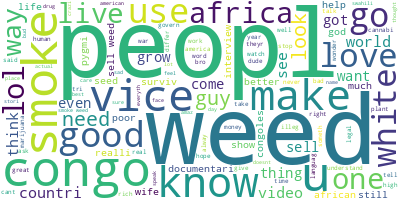

In [ ]:
from collections import Counter
from wordcloud import WordCloud
import pandas as pd
file_path = '/content/CSV Clean-Result Data Comment2.csv'
data_clean_cln = pd.read_csv(file_path)
long_string = ','.join(list(data_clean_cln['text_stemmedSTR'].astype(str).values))
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')
wordcloud.generate(long_string)
wordcloud.to_image()

Grafik kata-kata yang paling sering digunakan dalam komentar video pertama, dengan kata teratas yang paling sering digunakan adalah people sesuai dengan judul pada video kedua yang membahas tentang kehidupan sekelompok orang di afrika khususnya suku congo, yang dimana masyarakat lokal menghadapi tantangan sosial ekonomi meskipun kaya akan sumber daya alam, dengan kebutuhan yang mendesak akan perubahan dunia.

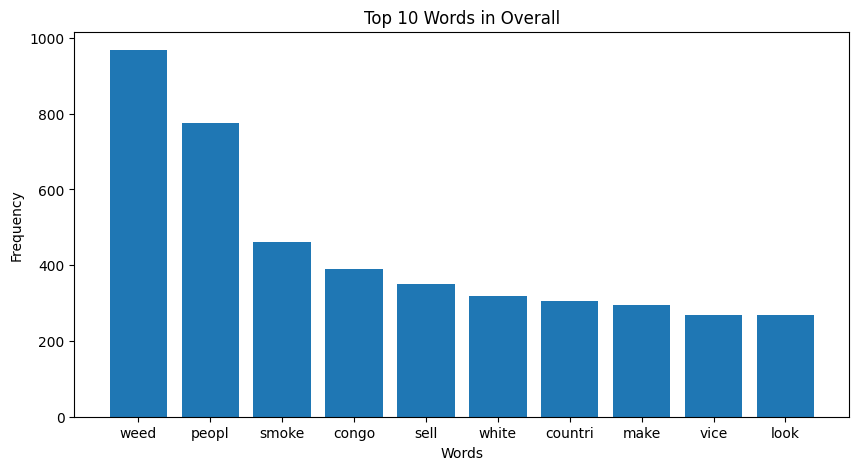

In [ ]:
from collections import Counter
from wordcloud import WordCloud
import pandas as pd
import matplotlib.pyplot as plt

file_path = '/content/CSV Clean-Result Data Comment2.csv'
data_clean_cln = pd.read_csv(file_path)

data_clean_cln['text_stemmedSTR'] = data_clean_cln['text_stemmedSTR'].astype(str).fillna('')

top_words = Counter(" ".join(data_clean_cln['text_stemmedSTR']).split()).most_common(10)

words, counts = zip(*top_words)
plt.figure(figsize=(10, 5))
plt.bar(words, counts)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Top 10 Words in Overall')
plt.show()

# feature engineering

## tf-idf

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
import pandas as pd

vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(data_clean_cln['text_stemmedSTR'])

tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=vectorizer.get_feature_names_out())

data_final_labeled = pd.concat([data_clean_cln, tfidf_df], axis=1)

display(data_final_labeled.head(50))

data_final_labeled.to_csv('CSV_Final_Featured_Data_Comment_Labeled.csv', index=False)

,text_stemmedSTR,aaaaaacunija,aaahhh,aap,aaron,ab,aba,abandon,abanyarwanda,abd,...,zip,zkittl,zond,zone,zonebrbigasoza,zoo,zoom,zoot,zulu,zz
0,watch fade,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,american tribe sell weed surviv,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,need chronic seed show grow,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,els watch high asf,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,roll joint line paper lol,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,stoner fli congo,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,song name begin video,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,illeg weed european bed lay brdown real soon b...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,send gift make sure peopl receiv way help trib...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,elder got chill realiz ne vice crew vanish,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### umap tf-idf

In [ ]:
!pip install umap-learn
!pip install plotly

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 5.2 MB/s eta 0:00:00


In [ ]:
import umap

response = data_final_labeled['text_stemmedSTR']
reducer = umap.UMAP()
X_umap = reducer.fit_transform(tfidf_df)

data_final_labeled['umap_1'] = X_umap[:, 0]
data_final_labeled['umap_2'] = X_umap[:, 1]

/usr/local/lib/python3.10/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [ ]:
import plotly.express as px
flg = px.scatter(data_final_labeled, x='umap_1', y='umap_2', title='UMAP Visualization', text='text_stemmedSTR')

flg.update_layout(height=650)
flg.show()

## word2vec

In [ ]:
!pip install gensim

In [ ]:
import pandas as pd
from gensim.models import Word2Vec

sentences = data_clean_cln['text_stemmedSTR'].dropna().apply(lambda x: x.split()).tolist()

model = Word2Vec(sentences, vector_size=100, window=5, min_count=1, workers=4)

model.wv.save_word2vec_format("/content/word2vec_model.bin", binary=True)
try:
    similar_words = model.wv.most_similar("weed", topn=500)
    similar_words_df = pd.DataFrame(similar_words, columns=['word', 'similarity_score'])
    print(similar_words_df)
    similar_words_df.to_csv("/content/similar_words_weed.csv", index=False)
except KeyError:
    print("Kata 'weed' tidak ditemukan dalam vocab model.")

         word  similarity_score
0         way          0.999755
1       thing          0.999754
2        look          0.999734
3        make          0.999733
4      africa          0.999732
..        ...               ...
495   kingdom          0.996544
496      save          0.996542
497     franc          0.996537
498      soon          0.996521
499  conflict          0.996508

[500 rows x 2 columns]


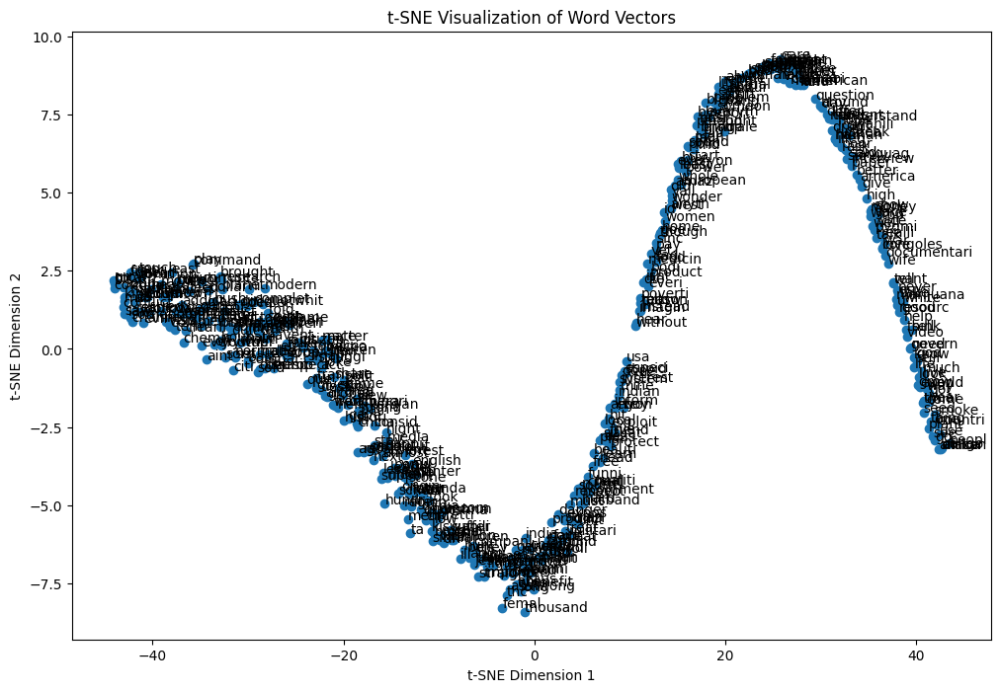

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.manifold import TSNE

if isinstance(similar_words, list):
    words = [word for word, _ in similar_words]
    vectors = [model.wv[word] for word in words]

    vectors = np.array(vectors)
    tsne = TSNE(n_components=2, random_state=0)
    vectors_2d = tsne.fit_transform(vectors)

    plt.figure(figsize=(12, 8))
    plt.scatter(vectors_2d[:, 0], vectors_2d[:, 1])

    for i, word in enumerate(words):
      plt.annotate(word, xy=(vectors_2d[i, 0], vectors_2d[i, 1]))

    plt.title('t-SNE Visualization of Word Vectors')
    plt.xlabel('t-SNE Dimension 1')
    plt.ylabel('t-SNE Dimension 2')
    plt.show()

else:
    print(similar_words)

###umap word2vec

In [ ]:
import umap
import pandas as pd

X = umap.UMAP().fit_transform(model.wv.vectors)

df2 = pd.DataFrame(X, columns=['umap1', 'umap2'])
df2['word'] = model.wv.index_to_key

fig = px.scatter(df2, x='umap1', y='umap2', text='word')
fig.update_traces(textposition='top center')
fig.update_layout(height = 800,
                  title_text = 'Word2Vec Visualization')
fig.show()

/usr/local/lib/python3.10/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



## bag of word

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd

bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(data_clean_cln['text_stemmedSTR'])

bow_df = pd.DataFrame(bow_matrix.toarray(), columns=bow_vectorizer.get_feature_names_out())


data_final_bow = pd.concat([data_clean_cln, bow_df], axis=1)

display(data_final_bow.head(50))


data_final_bow.to_csv('CSV_Final_BoW_Data_Comment.csv', index=False)


,text_stemmedSTR,aaaaaacunija,aaahhh,aap,aaron,ab,aba,abandon,abanyarwanda,abd,...,zip,zkittl,zond,zone,zonebrbigasoza,zoo,zoom,zoot,zulu,zz
0,watch fade,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,american tribe sell weed surviv,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,need chronic seed show grow,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,els watch high asf,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,roll joint line paper lol,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,stoner fli congo,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,song name begin video,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,illeg weed european bed lay brdown real soon b...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,send gift make sure peopl receiv way help trib...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,elder got chill realiz ne vice crew vanish,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


<ipython-input-46-5df0cecb3f70>:19: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




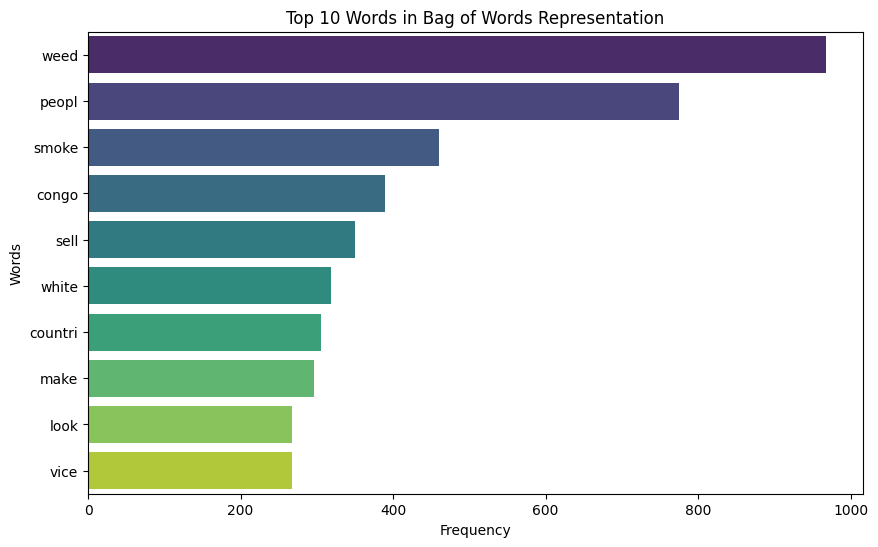

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd

bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(data_clean_cln['text_stemmedSTR'])


bow_df = pd.DataFrame(bow_matrix.toarray(), columns=bow_vectorizer.get_feature_names_out())


word_counts = bow_df.sum(axis=0).sort_values(ascending=False)

top_words = word_counts.head(10)

plt.figure(figsize=(10, 6))
sns.barplot(x=top_words.values, y=top_words.index, palette="viridis")
plt.xlabel('Frequency')
plt.ylabel('Words')
plt.title('Top 10 Words in Bag of Words Representation')
plt.show()


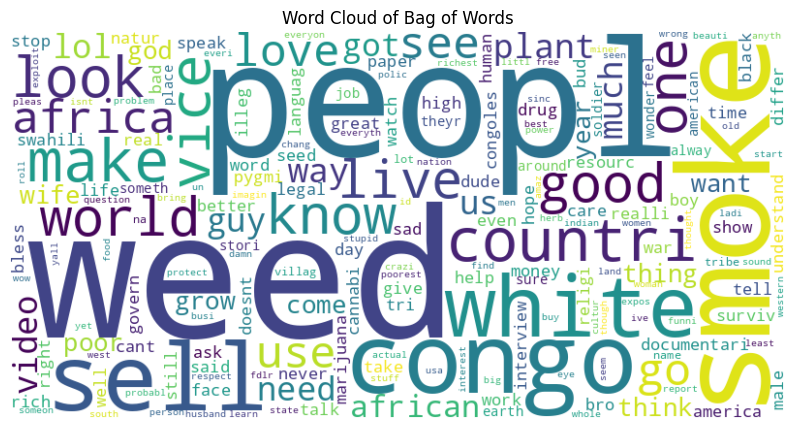

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd


bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(data_clean_cln['text_stemmedSTR'])


bow_df = pd.DataFrame(bow_matrix.toarray(), columns=bow_vectorizer.get_feature_names_out())

word_counts = bow_df.sum(axis=0)


wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis').generate_from_frequencies(word_counts)

plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Bag of Words')
plt.show()

## fasttext

In [ ]:
!pip install fasttext

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.4/73.4 kB 2.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached pybind11-2.13.6-py3-none-any.whl.metadata (9.5 kB)
Using cached pybind11-2.13.6-py3-none-any.whl (243 kB)
  Created wheel for fasttext: filename=fasttext-0.9.3-cp310-cp310-linux_x86_64.whl size=4296230 sha256=456cc7f7cb770f826aca907104b93913ec660a8b535433ad5ba19bb6eb3e7c03
  Stored in directory: /root/.cache/pip/wheels/0d/a2/00/81db54d3e6a8199b829d58e02cec2ddb20ce3e59fad8d3c92a
Successfully built fasttext


In [ ]:
import fasttext
from gensim.models import FastText
import pandas as pd

sentences = data_clean_cln['text_stemmedSTR'].dropna().apply(lambda x: x.split()).tolist()

model = FastText(sentences, vector_size=100, window=5, min_count=1, workers=4)

# Change: Call save_fasttext_format on the model object, not model.wv
model.save("/content/fasttext_model.bin")

try:
    similar_words = model.wv.most_similar("weed", topn=500)
    similar_words_df = pd.DataFrame(similar_words, columns=['word', 'similarity_score'])
    print(similar_words_df)
    similar_words_df.to_csv("/content/similar_words_weed.csv", index=False)
except KeyError:
    print("Kata 'weed' tidak ditemukan dalam vocab model.")

            word  similarity_score
0          weedi          0.999993
1          weeed          0.999992
2        weedget          0.999992
3         weedic          0.999992
4         weedon          0.999991
..           ...               ...
495       listen          0.999980
496          pro          0.999980
497     realidad          0.999980
498  everytimeil          0.999980
499      quotthi          0.999980

[500 rows x 2 columns]


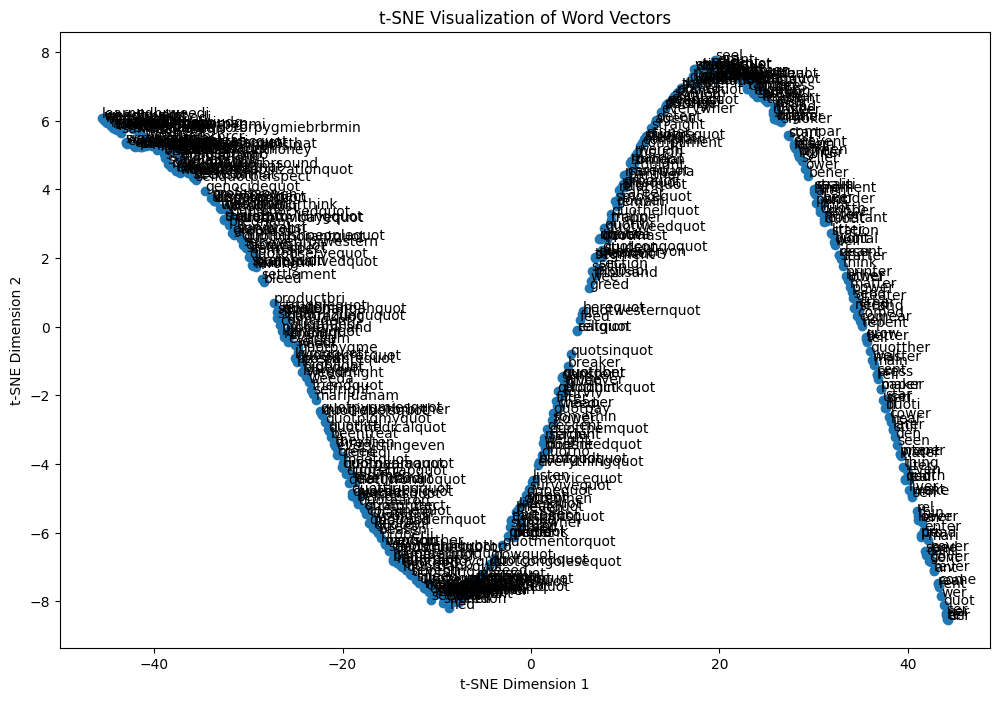

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.manifold import TSNE

if isinstance(similar_words, list):
    words = [word for word, _ in similar_words]
    vectors = [model.wv[word] for word in words]

    vectors = np.array(vectors)
    tsne = TSNE(n_components=2, random_state=0)
    vectors_2d = tsne.fit_transform(vectors)

    plt.figure(figsize=(12, 8))
    plt.scatter(vectors_2d[:, 0], vectors_2d[:, 1])

    for i, word in enumerate(words):
      plt.annotate(word, xy=(vectors_2d[i, 0], vectors_2d[i, 1]))

    plt.title('t-SNE Visualization of Word Vectors')
    plt.xlabel('t-SNE Dimension 1')
    plt.ylabel('t-SNE Dimension 2')
    plt.show()

else:
    print(similar_words)

# CLUSTERING DENGAN TF IDF

In [ ]:
df2=data_clean_cln[['text_stemmedSTR']]
df1=df2[:300]
df1.head(50)

,text_stemmedSTR
0,watch fade
1,american tribe sell weed surviv
2,need chronic seed show grow
3,els watch high asf
4,roll joint line paper lol
5,stoner fli congo
6,song name begin video
7,illeg weed european bed lay brdown real soon b...
8,send gift make sure peopl receiv way help trib...
9,elder got chill realiz ne vice crew vanish


##KMean

In [ ]:
!pip install scikit-learn
!pip install wordcloud

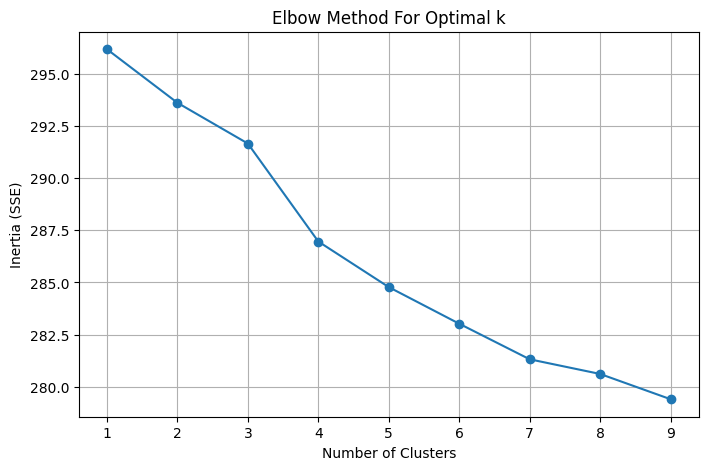

In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer
import matplotlib.pyplot as plt

vectorizer = TfidfVectorizer()

tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

inertia = []
cluster_range = range(1, 10)

for k in cluster_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(tfidf_matrix)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(cluster_range, inertia, marker='o')
plt.title('Elbow Method For Optimal k')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia (SSE)')
plt.xticks(cluster_range)
plt.grid(True)
plt.show()

In [ ]:
num_clusters = 4

vectorizer = TfidfVectorizer()

tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

kmeans = KMeans(n_clusters=num_clusters, random_state=42)

df1['Cluster_KMeans'] = kmeans.fit_predict(tfidf_matrix)
df1.head(50)

<ipython-input-54-68ce6f6dbf7f>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans
0,watch fade,2
1,american tribe sell weed surviv,3
2,need chronic seed show grow,2
3,els watch high asf,2
4,roll joint line paper lol,2
5,stoner fli congo,2
6,song name begin video,2
7,illeg weed european bed lay brdown real soon b...,3
8,send gift make sure peopl receiv way help trib...,0
9,elder got chill realiz ne vice crew vanish,2


In [ ]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score

silhouette_avg = silhouette_score(tfidf_matrix, df1['Cluster_KMeans'])
print(f"The average silhouette_score is : {silhouette_avg}")

The average silhouette_score is : 0.009527498560061944


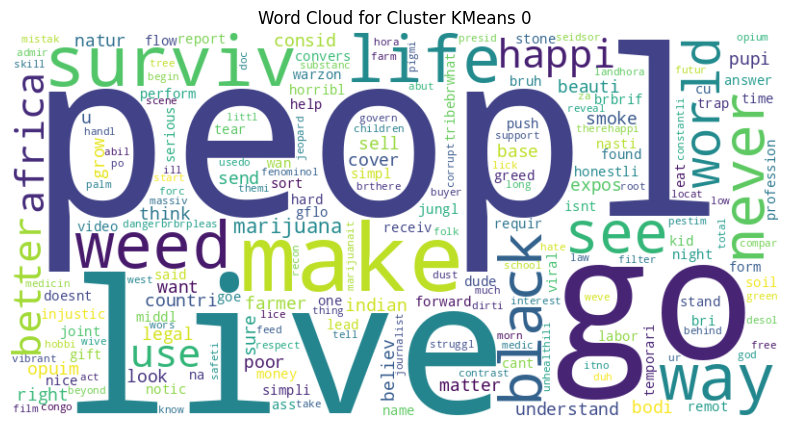

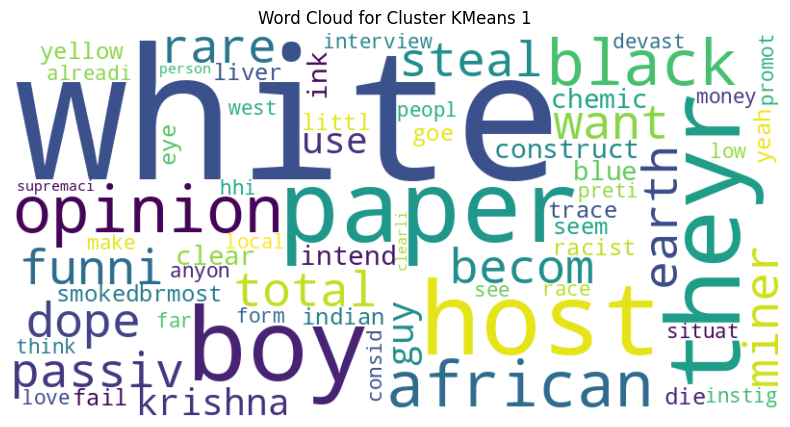

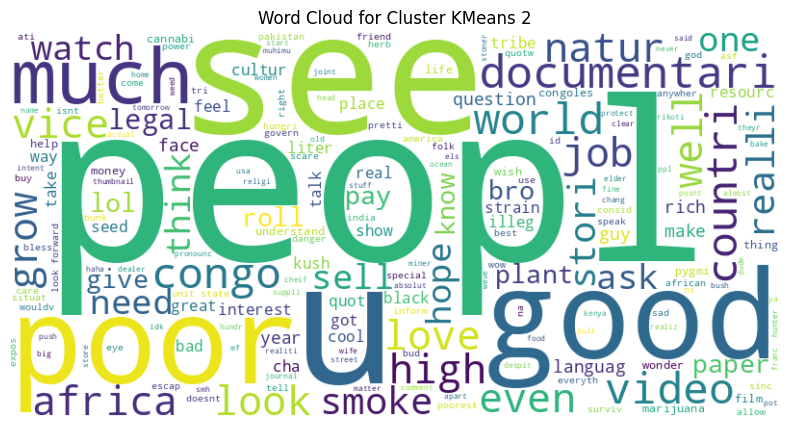

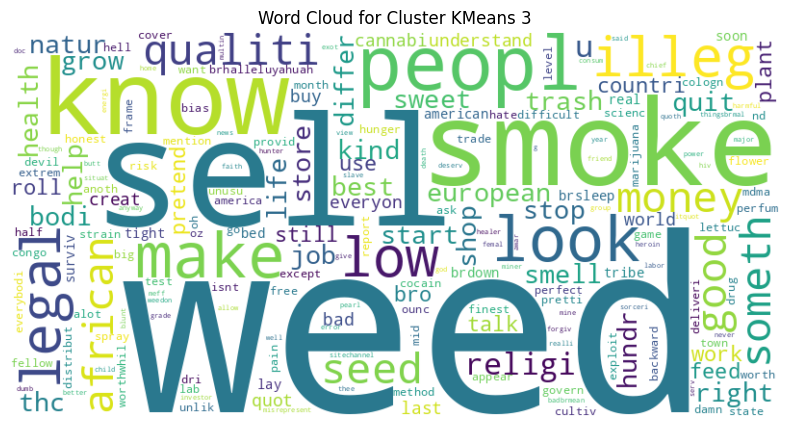

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

for i in range(num_clusters):
    text = " ".join(review for review in df1[df1['Cluster_KMeans'] == i]['text_stemmedSTR'])
    wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Word Cloud for Cluster KMeans {i}")
    plt.show()

##hierarchy clustering

In [ ]:
!pip install scikit-learn matplotlib scipy

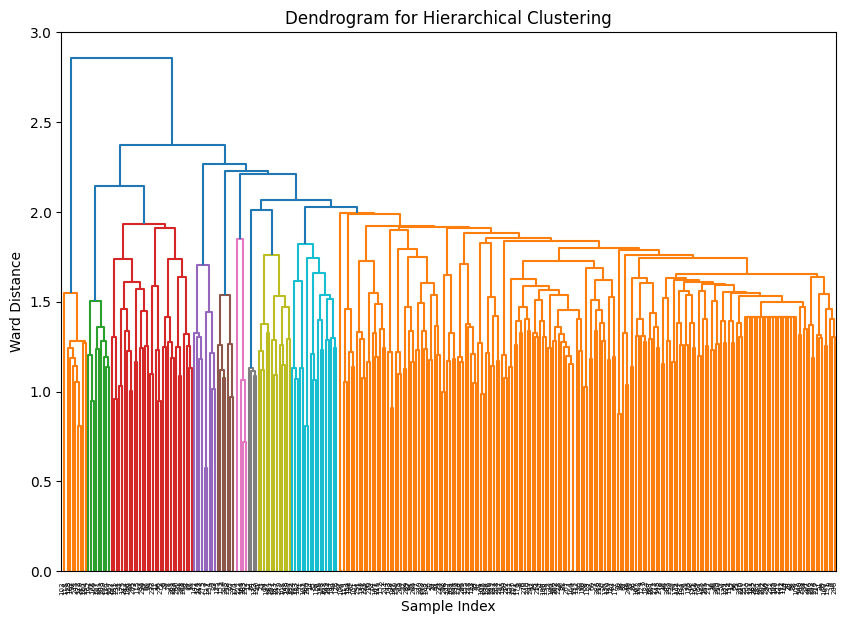

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import AgglomerativeClustering
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as sch

vectorizer = TfidfVectorizer(stop_words='english')

tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(tfidf_matrix.toarray(), method='ward', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Ward Distance')
plt.show()

In [ ]:
tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

num_clusters = 4

clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='ward')

df1['Cluster_H_Ward'] = clustering.fit_predict(tfidf_matrix.toarray())

df1.head(50)

<ipython-input-59-1c33458a5f2b>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward
0,watch fade,2,1
1,american tribe sell weed surviv,3,0
2,need chronic seed show grow,2,0
3,els watch high asf,2,1
4,roll joint line paper lol,2,0
5,stoner fli congo,2,0
6,song name begin video,2,2
7,illeg weed european bed lay brdown real soon b...,3,0
8,send gift make sure peopl receiv way help trib...,0,0
9,elder got chill realiz ne vice crew vanish,2,0


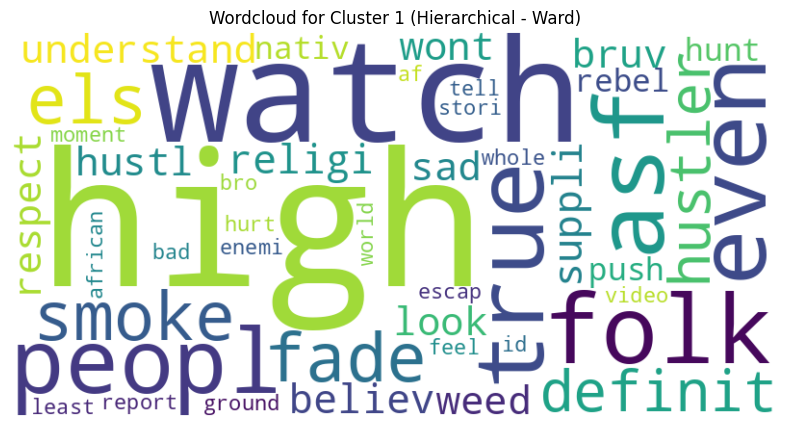

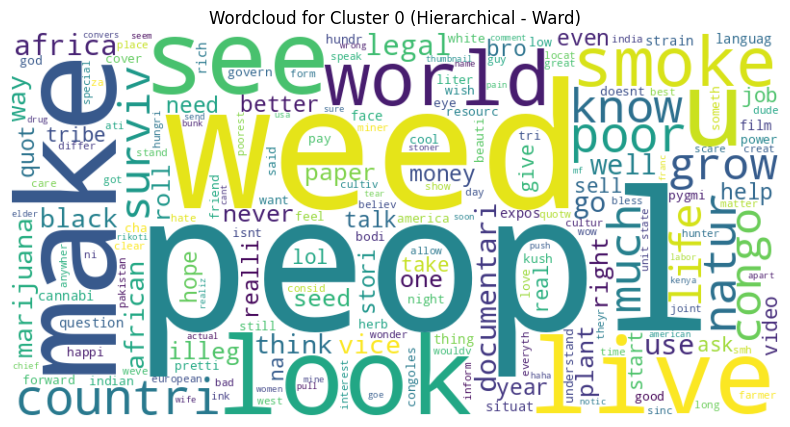

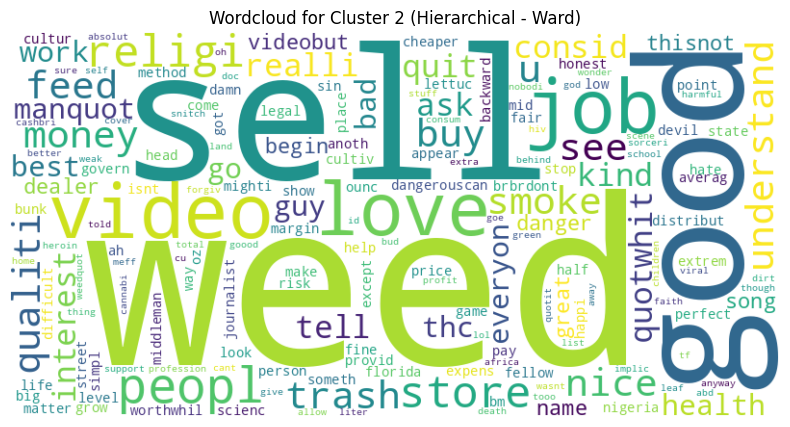

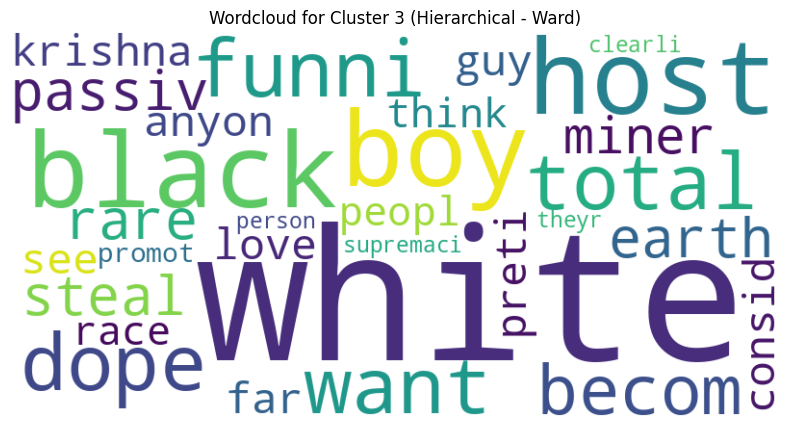

In [ ]:
def plot_wordcloud(text, title):
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

for cluster in df1['Cluster_H_Ward'].unique():
    text = ' '.join(df1[df1['Cluster_H_Ward'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Ward)')

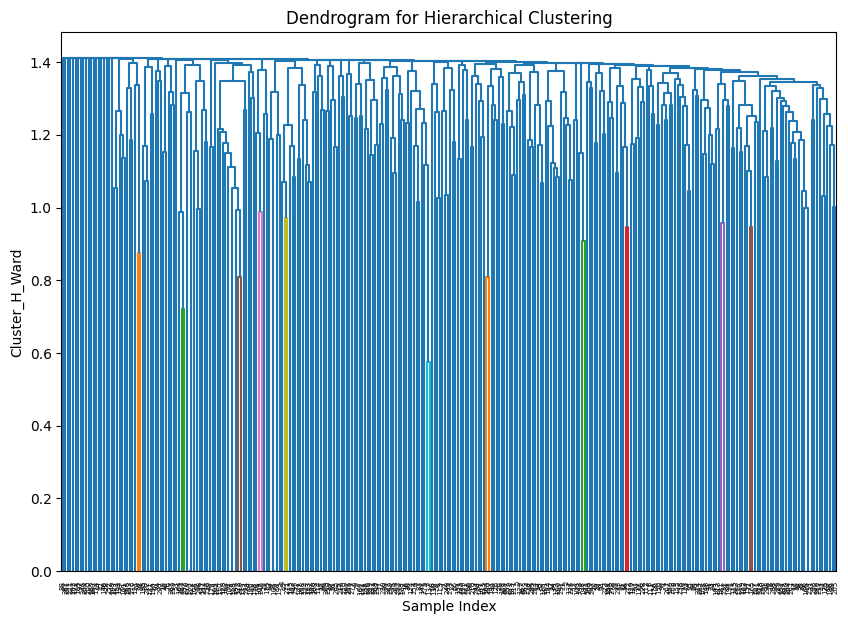

In [ ]:
vectorizer = TfidfVectorizer(stop_words='english')

tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(tfidf_matrix.toarray(), method='average', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Ward')
plt.show()

In [ ]:
tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

num_clusters = 4

clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='average')

df1['Cluster_H_Average'] = clustering.fit_predict(tfidf_matrix.toarray())

df1.head(50)

<ipython-input-62-a27660b1483d>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average
0,watch fade,2,1,0
1,american tribe sell weed surviv,3,0,0
2,need chronic seed show grow,2,0,0
3,els watch high asf,2,1,0
4,roll joint line paper lol,2,0,0
5,stoner fli congo,2,0,0
6,song name begin video,2,2,0
7,illeg weed european bed lay brdown real soon b...,3,0,0
8,send gift make sure peopl receiv way help trib...,0,0,0
9,elder got chill realiz ne vice crew vanish,2,0,0


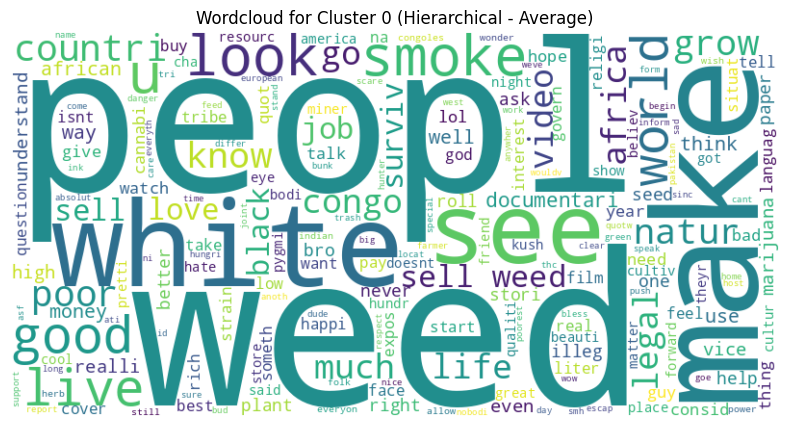

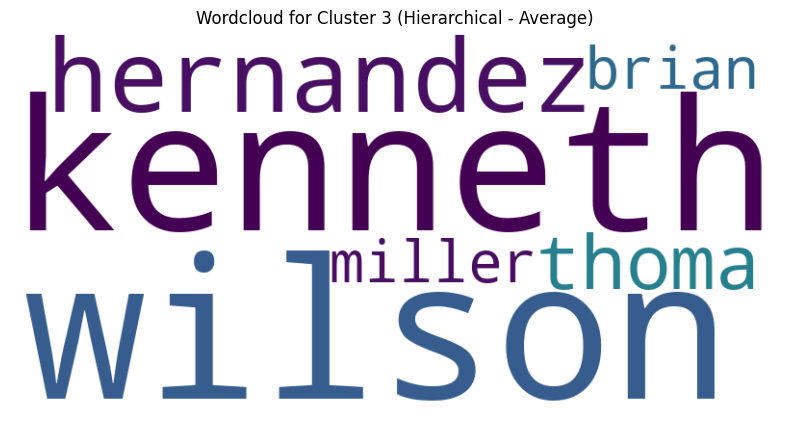

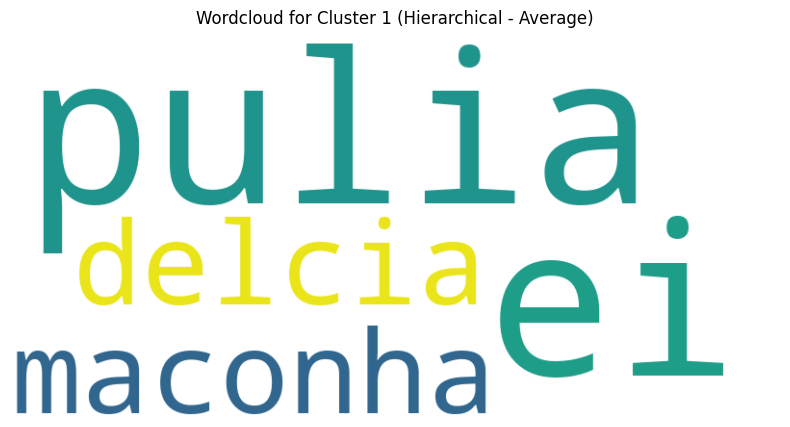

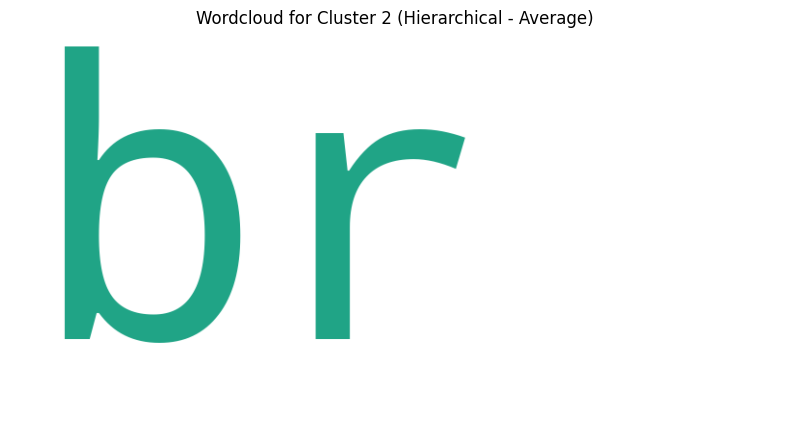

In [ ]:
for cluster in df1['Cluster_H_Average'].unique():
    text = ' '.join(df1[df1['Cluster_H_Average'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Average)')

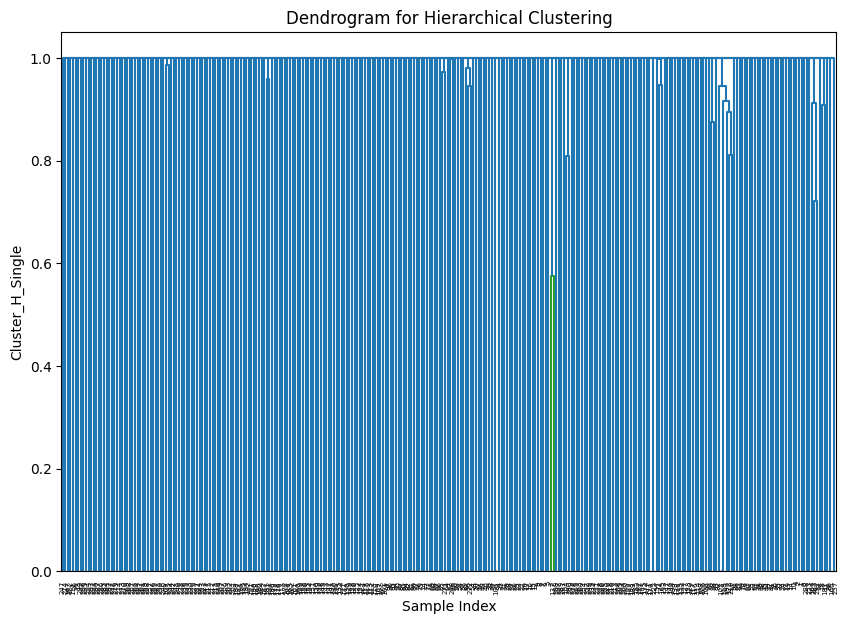

In [ ]:
vectorizer = TfidfVectorizer(stop_words='english')
tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(tfidf_matrix.toarray(), method='single', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Single')
plt.show()

In [ ]:
tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

num_clusters = 4

clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='single')

df1['Cluster_H_Single'] = clustering.fit_predict(tfidf_matrix.toarray())

df1.head(50)

<ipython-input-65-4a6d61c8bd74>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single
0,watch fade,2,1,0,0
1,american tribe sell weed surviv,3,0,0,0
2,need chronic seed show grow,2,0,0,0
3,els watch high asf,2,1,0,0
4,roll joint line paper lol,2,0,0,0
5,stoner fli congo,2,0,0,0
6,song name begin video,2,2,0,0
7,illeg weed european bed lay brdown real soon b...,3,0,0,0
8,send gift make sure peopl receiv way help trib...,0,0,0,0
9,elder got chill realiz ne vice crew vanish,2,0,0,0


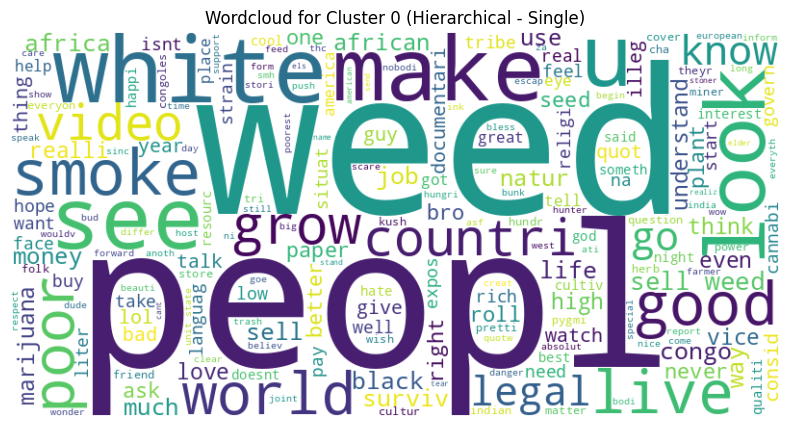

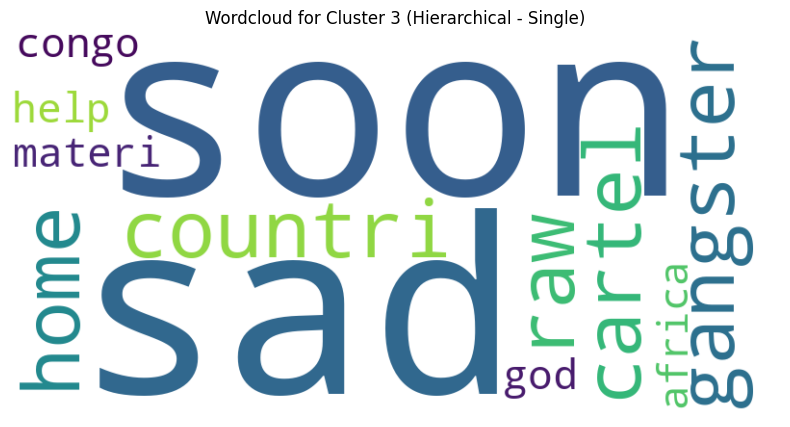

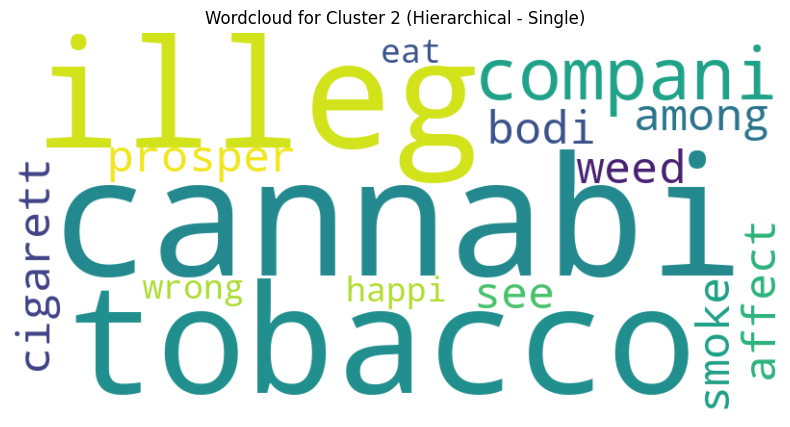

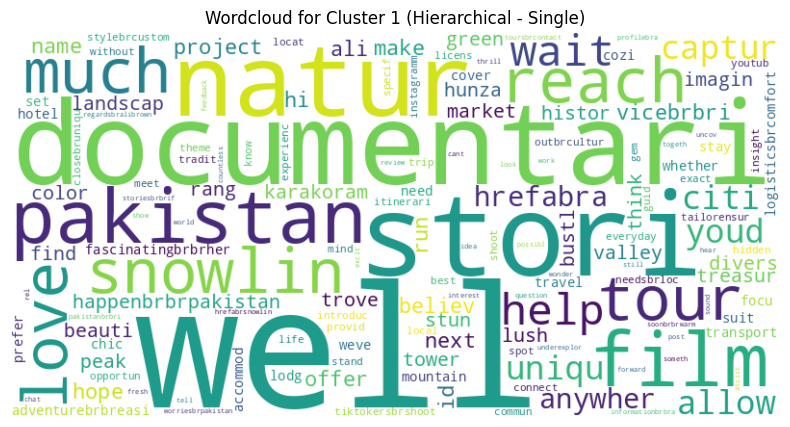

In [ ]:
for cluster in df1['Cluster_H_Single'].unique():
    text = ' '.join(df1[df1['Cluster_H_Single'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Single)')

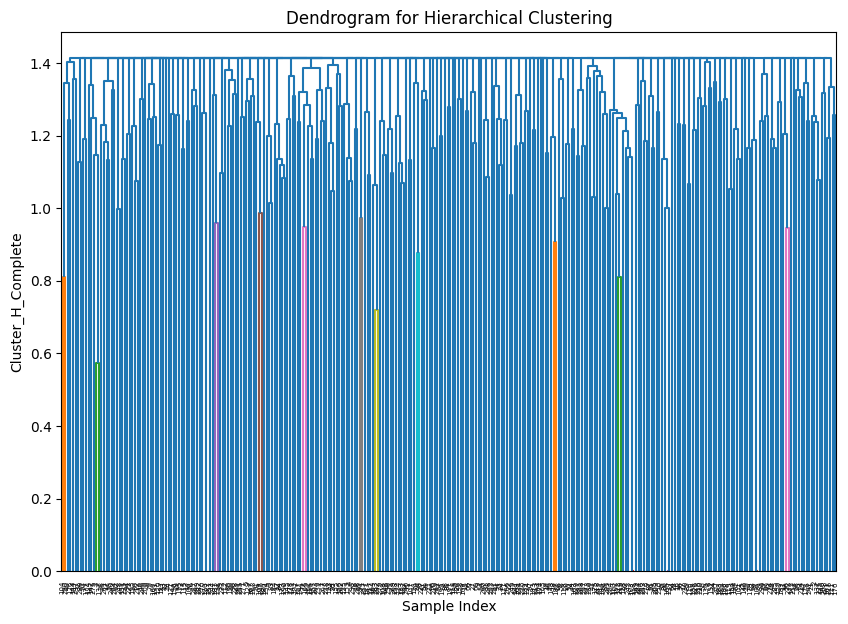

In [ ]:
vectorizer = TfidfVectorizer(stop_words='english')
tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(tfidf_matrix.toarray(), method='complete', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Complete')
plt.show()

In [ ]:
tfidf_matrix = vectorizer.fit_transform(df1['text_stemmedSTR'])

num_clusters = 4

clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='complete')

df1['Cluster_H_Complete'] = clustering.fit_predict(tfidf_matrix.toarray())

df1.head(50)

<ipython-input-68-d3d7470a6cbe>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete
0,watch fade,2,1,0,0,2
1,american tribe sell weed surviv,3,0,0,0,2
2,need chronic seed show grow,2,0,0,0,0
3,els watch high asf,2,1,0,0,2
4,roll joint line paper lol,2,0,0,0,2
5,stoner fli congo,2,0,0,0,2
6,song name begin video,2,2,0,0,2
7,illeg weed european bed lay brdown real soon b...,3,0,0,0,1
8,send gift make sure peopl receiv way help trib...,0,0,0,0,0
9,elder got chill realiz ne vice crew vanish,2,0,0,0,1


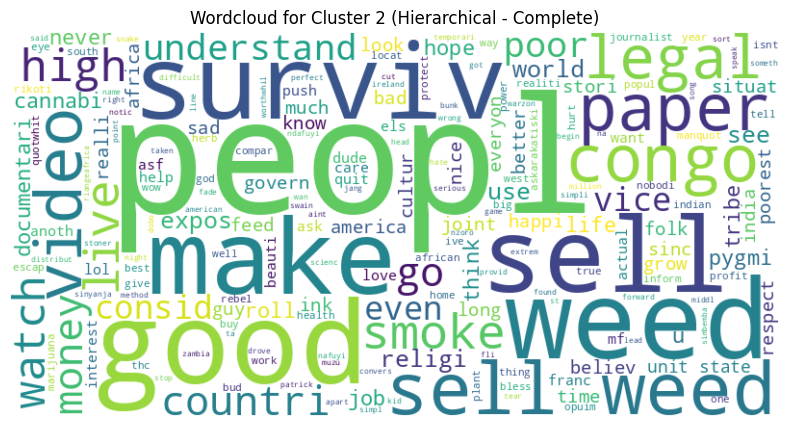

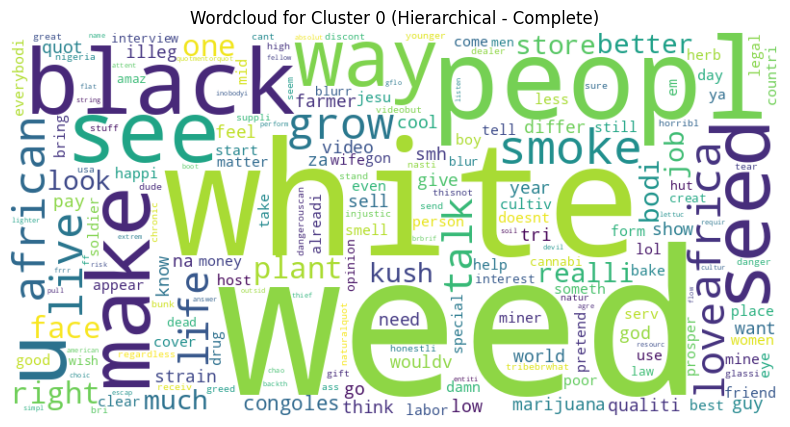

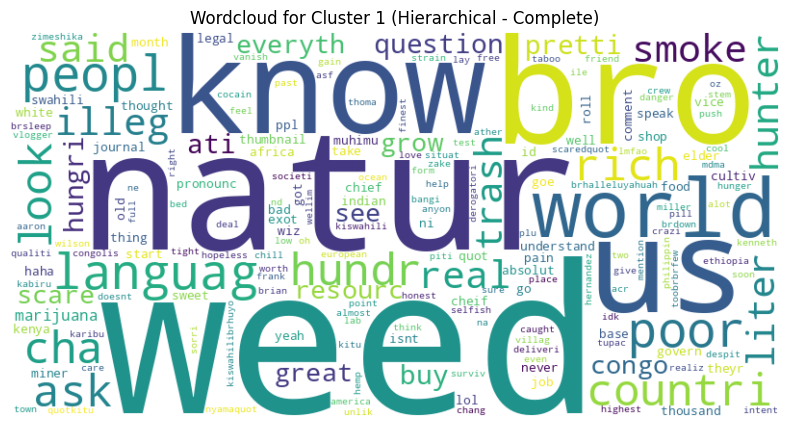

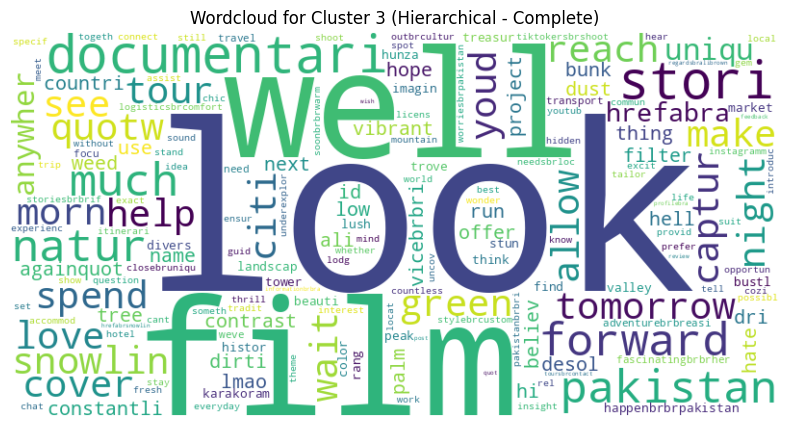

In [ ]:
for cluster in df1['Cluster_H_Complete'].unique():
    text = ' '.join(df1[df1['Cluster_H_Complete'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Complete)')

In [ ]:
linkage_methods = ['single', 'complete', 'average', 'ward']

for method in linkage_methods:
  agg_clustering = AgglomerativeClustering(n_clusters=4, linkage=method, metric='euclidean')
  agg_clustering.fit(tfidf_matrix.toarray())

  print(f"Cluster Labels for {method} linkage:")
  labels = agg_clustering.labels_
  silhouette_avg = silhouette_score(tfidf_matrix.toarray(), labels)
  print(f"For {method} linkage:")
  print(f"The average silhouette_score is : {silhouette_avg}")
  print("--------------------------------------------------------------------")

Cluster Labels for single linkage:
For single linkage:
The average silhouette_score is : -0.01019630538846704
--------------------------------------------------------------------
Cluster Labels for complete linkage:
For complete linkage:
The average silhouette_score is : 0.0006380889044775917
--------------------------------------------------------------------
Cluster Labels for average linkage:
For average linkage:
The average silhouette_score is : 0.007015126926588081
--------------------------------------------------------------------
Cluster Labels for ward linkage:
For ward linkage:
The average silhouette_score is : 0.012715765674457487
--------------------------------------------------------------------


In [ ]:
df1.to_csv('YouTube2_TFIDF_Cluster.csv', index=False)

#clustering BOW

## KMean

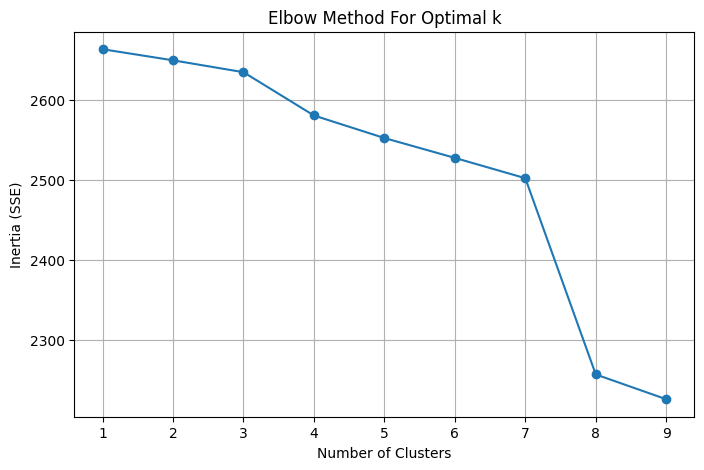

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
import seaborn as sns
from sklearn.cluster import KMeans

bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])

inertia = []
cluster_range = range(1, 10)

for k in cluster_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(bow_matrix)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(cluster_range, inertia, marker='o')
plt.title('Elbow Method For Optimal k')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia (SSE)')
plt.xticks(cluster_range)
plt.grid(True)
plt.show()

In [ ]:
num_clusters = 4

bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])

kmeans = KMeans(n_clusters=num_clusters, random_state=42)

df1['Cluster_KMeans'] = kmeans.fit_predict(bow_matrix)

df1.head(50)

<ipython-input-73-0c592705d5ee>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete
0,watch fade,1,1,0,0,2
1,american tribe sell weed surviv,1,0,0,0,2
2,need chronic seed show grow,1,0,0,0,0
3,els watch high asf,1,1,0,0,2
4,roll joint line paper lol,1,0,0,0,2
5,stoner fli congo,1,0,0,0,2
6,song name begin video,1,2,0,0,2
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1
8,send gift make sure peopl receiv way help trib...,1,0,0,0,0
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1


In [ ]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score

silhouette_avg = silhouette_score(bow_matrix, df1['Cluster_KMeans'])
print(f"The average silhouette_score is : {silhouette_avg}")

The average silhouette_score is : 0.18108833172859978


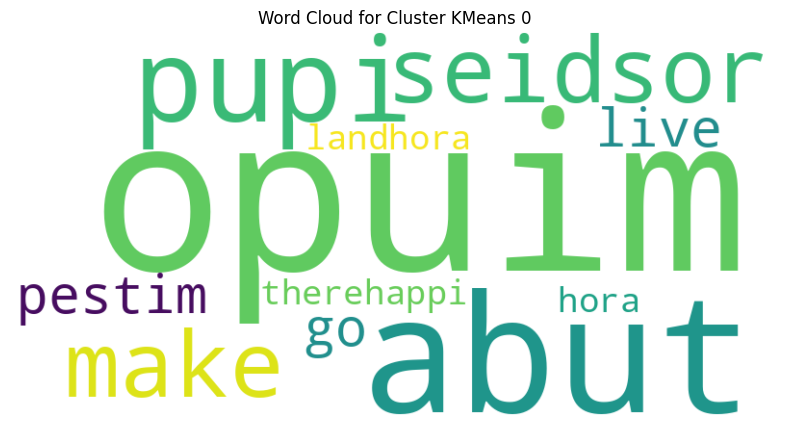

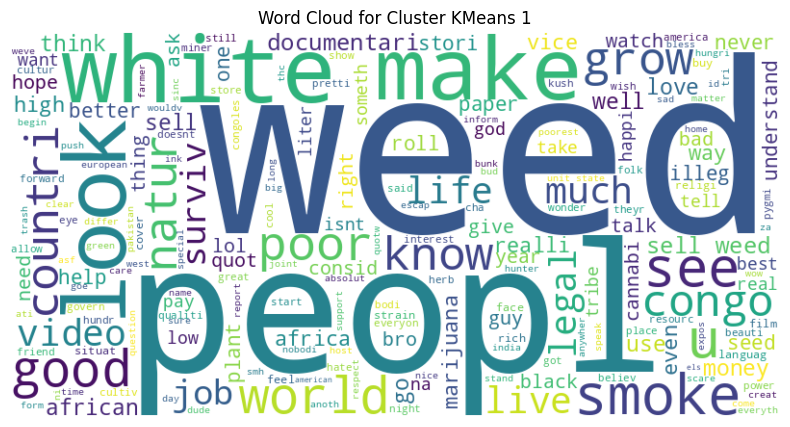

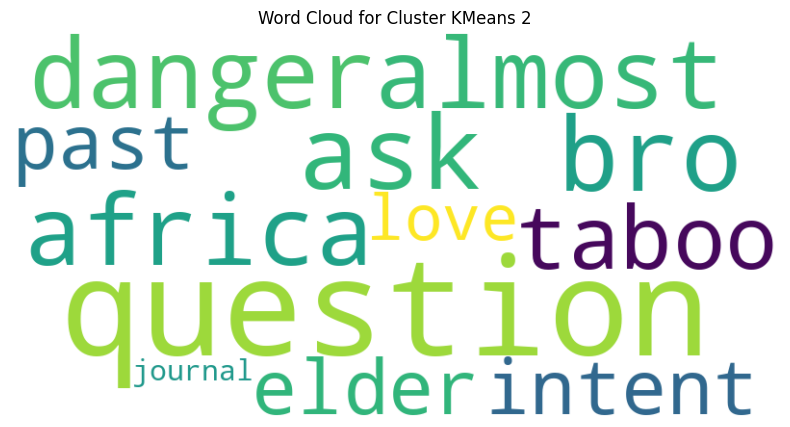

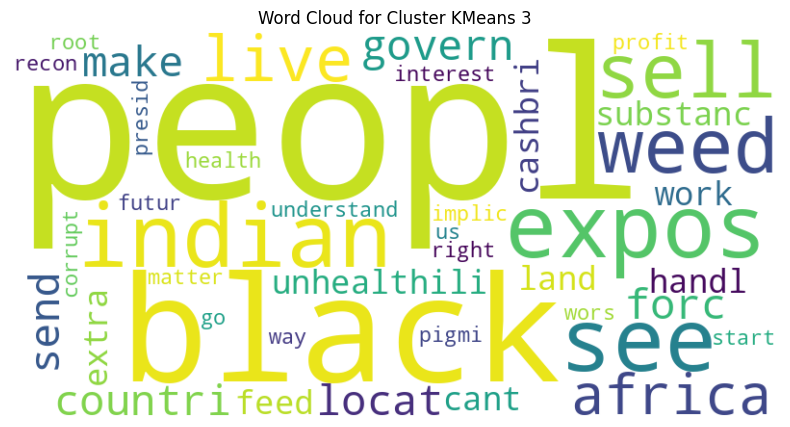

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

for i in range(num_clusters):
    text = " ".join(review for review in df1[df1['Cluster_KMeans'] == i]['text_stemmedSTR'])
    wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Word Cloud for Cluster KMeans {i}")
    plt.show()

cluster 0:
dapat disimpulkan bahwa cluster ini menjelaskan tentang  kehidupan masyarakat di Afrika, terutama Kongo, dengan fokus pada kekayaan sumber daya alam dan tantangan sosial-ekonomi. Komentar mencerminkan perhatian terhadap keadilan, keberlanjutan, dan harapan untuk perubahan positif.

cluster 1:
dapat disimpulkan bahwa cluster ini menjelaskan tentang hubungan keluarga, seperti famili, brother, dan sister, serta dampak kebijakan pemerintah terhadap kehidupan pribadi. Meskipun terbatas, tema yang muncul mencerminkan pengalaman pribadi yang mendalam dan penuh makna.


## hierarchy clustering

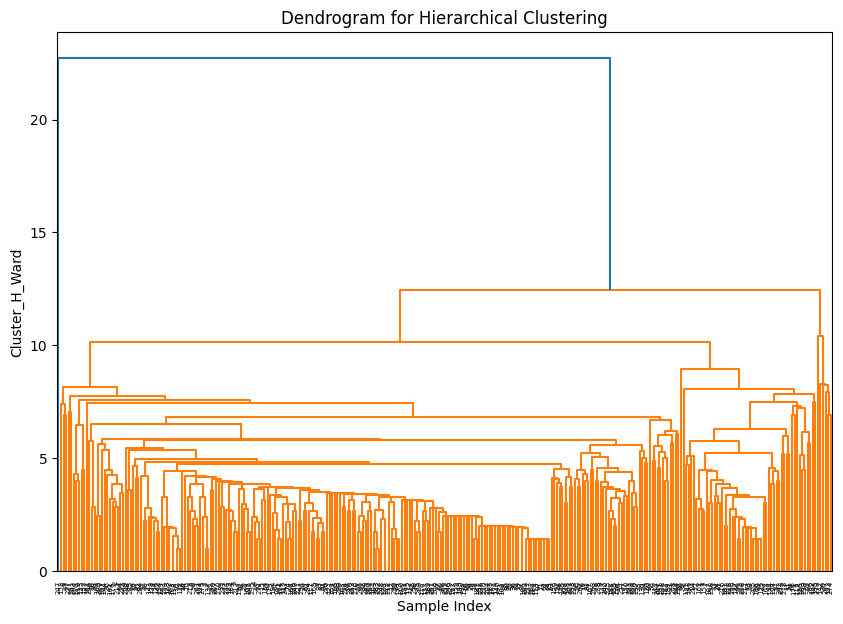

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
import seaborn as sns
from sklearn.cluster import KMeans
import scipy.cluster.hierarchy as sch
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score

bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(bow_matrix.toarray(), method='ward', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Ward')
plt.show()

In [ ]:
bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])
num_clusters = 4
clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='ward')
df1['Cluster_H_Ward'] = clustering.fit_predict(bow_matrix.toarray())
df1.head(50)

<ipython-input-77-618ea06f257d>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete
0,watch fade,1,0,0,0,2
1,american tribe sell weed surviv,1,0,0,0,2
2,need chronic seed show grow,1,0,0,0,0
3,els watch high asf,1,0,0,0,2
4,roll joint line paper lol,1,0,0,0,2
5,stoner fli congo,1,0,0,0,2
6,song name begin video,1,0,0,0,2
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1
8,send gift make sure peopl receiv way help trib...,1,0,0,0,0
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1


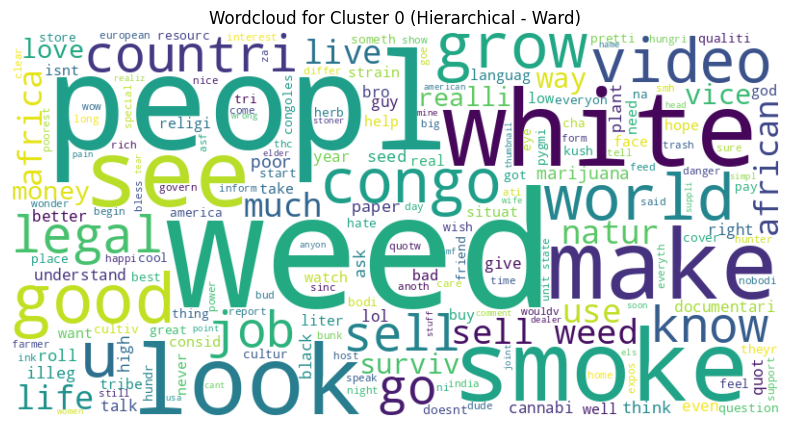

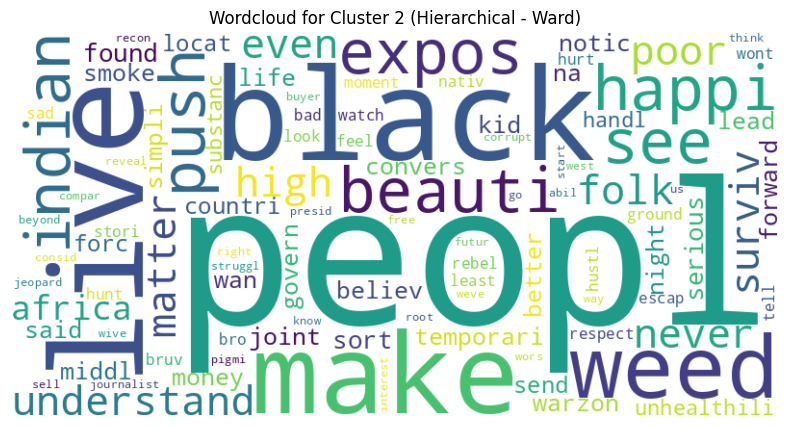

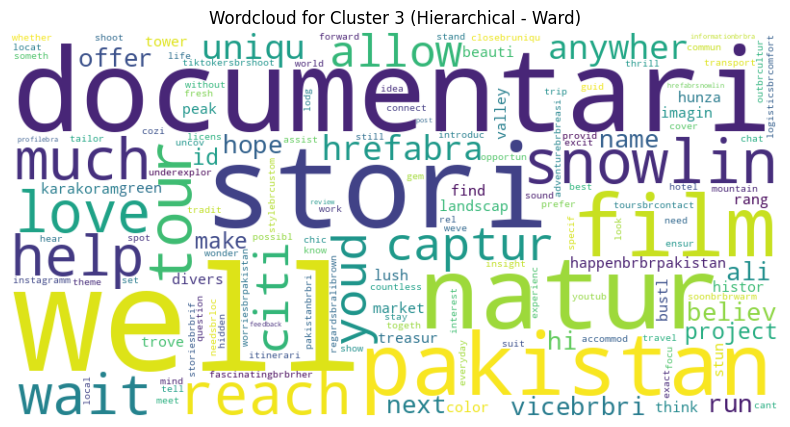

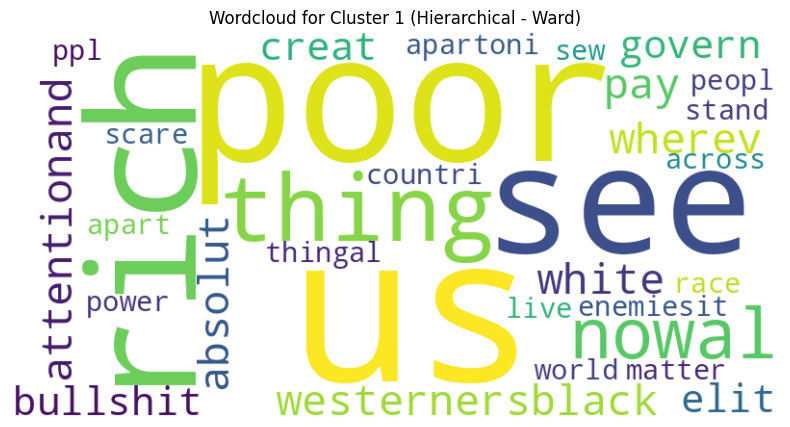

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
def plot_wordcloud(text, title):
    stop_words = set(STOPWORDS)
    stop_words.update(['famili', 'sister', 'brother', 'al', 'one', 'mijeda', 'bank', 'ok', 'faso', 'mijeda', 'aqsa', 'thiev', 'burkina', 'airlin', 'ga', 'car', 'amid', 'rawand', 'water', 'intern', 'brbr', 'miner', 'jesu', 'mali', 'okay', 'rafah', 'bu', 'togo', 'truck'])
    wordcloud = WordCloud(width=800, height=400, background_color='white', stopwords=stop_words).generate(text)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

for cluster in df1['Cluster_H_Ward'].unique():
    text = ' '.join(df1[df1['Cluster_H_Ward'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Ward)')

cluster 0:
dapat disimpulkan bahwa cluster ini menjelaskan tentang  masyarakat Afrika, dengan fokus pada sumber daya, perjuangan sosial, dan dampaknya terhadap dunia. Tema yang muncul mencerminkan keseimbangan antara tantangan dan potensi Afrika dalam konteks global.


cluster 1:
dapat disimpulkan bahwa cluster ini menjelaskan tentang hubungan keluarga dan perjuangan individu, dengan sentuhan kritik terhadap pemerintah. Teks mencerminkan keprihatinan sosial yang mendalam serta pengalaman emosional yang kuat.

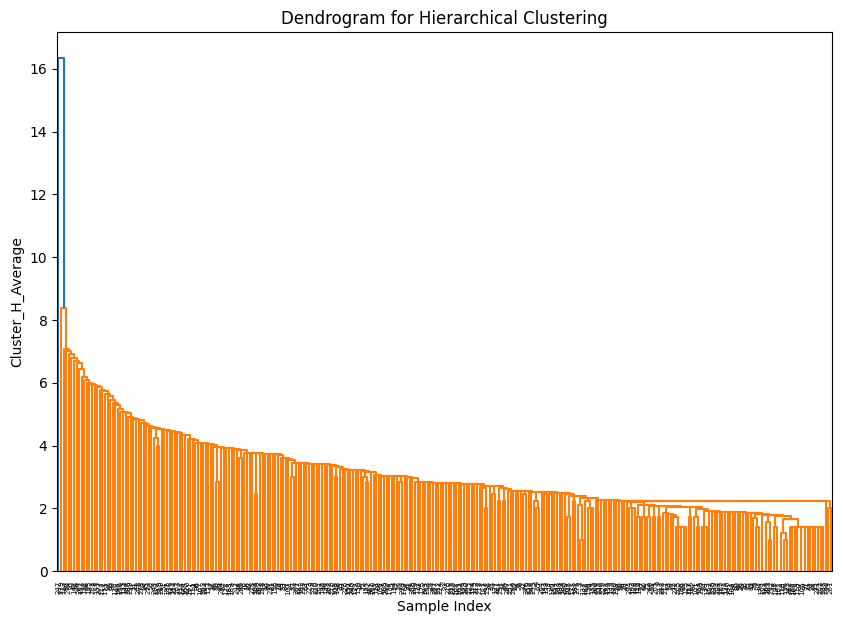

In [ ]:
bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(bow_matrix.toarray(), method='average', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Average')
plt.show()

In [ ]:
bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])

num_clusters = 4

clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='average')

df1['Cluster_H_Average'] = clustering.fit_predict(bow_matrix.toarray())

df1.head(50)

<ipython-input-80-a49f27cb01a2>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete
0,watch fade,1,0,0,0,2
1,american tribe sell weed surviv,1,0,0,0,2
2,need chronic seed show grow,1,0,0,0,0
3,els watch high asf,1,0,0,0,2
4,roll joint line paper lol,1,0,0,0,2
5,stoner fli congo,1,0,0,0,2
6,song name begin video,1,0,0,0,2
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1
8,send gift make sure peopl receiv way help trib...,1,0,0,0,0
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1


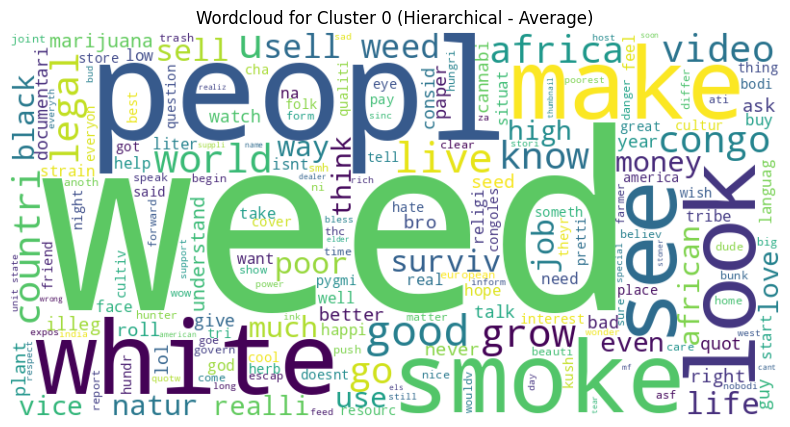

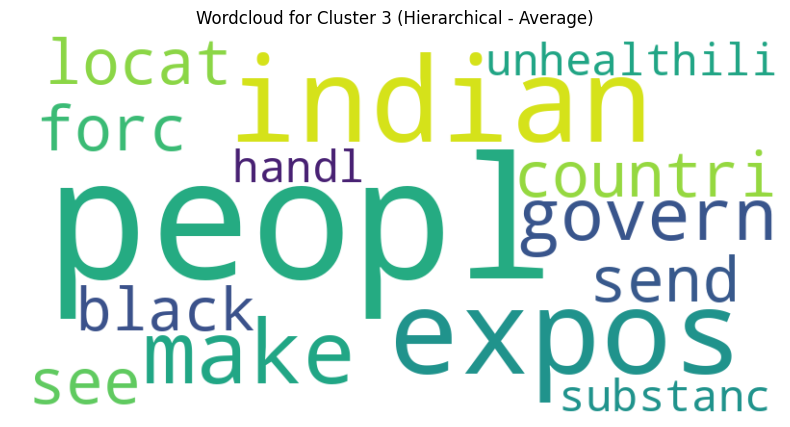

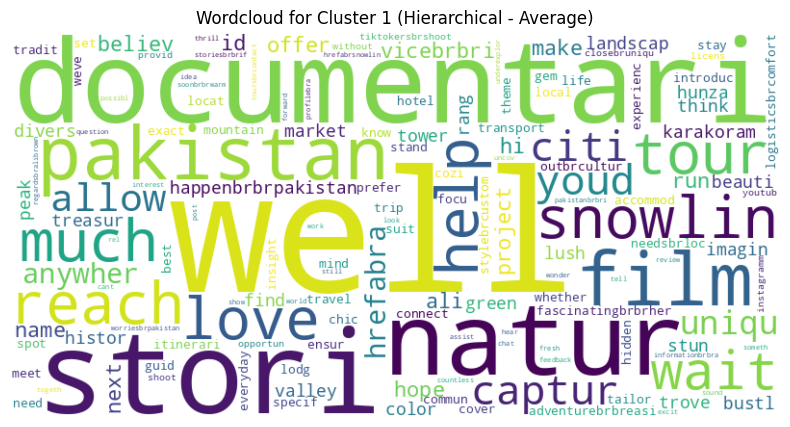

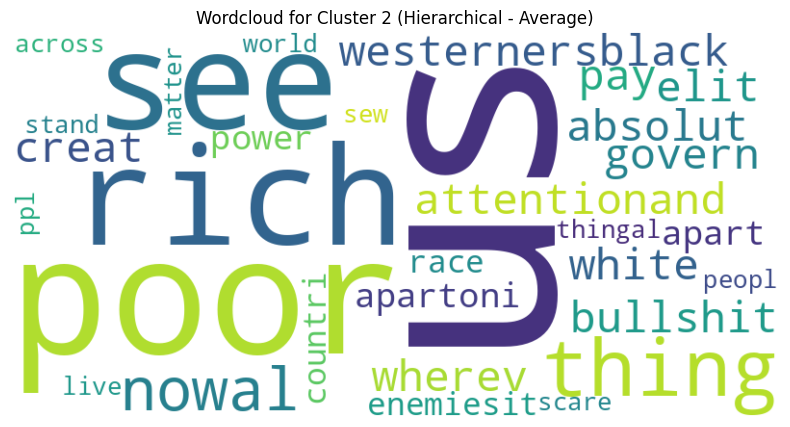

In [ ]:
for cluster in df1['Cluster_H_Average'].unique():
    text = ' '.join(df1[df1['Cluster_H_Average'] == cluster]['text_stemmedSTR'])

    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Average)')

cluster 0:
dapat disimpulkan bahwa cluster ini menjelaskan tentang masyarakat Afrika dan perjuangan mereka menghadapi tantangan global. Teks mencerminkan apresiasi terhadap kekayaan budaya dan sumber daya yang dimiliki.

cluster 1:
dapat disimpulkan bahwa cluster ini menjelaskan tentang isu sosial dan geografis, dengan tema tentang masyarakat Afrika dan perjuangan mereka menghadapi tantangan global. Teks mencerminkan apresiasi terhadap kekayaan budaya dan sumber daya yang dimiliki.


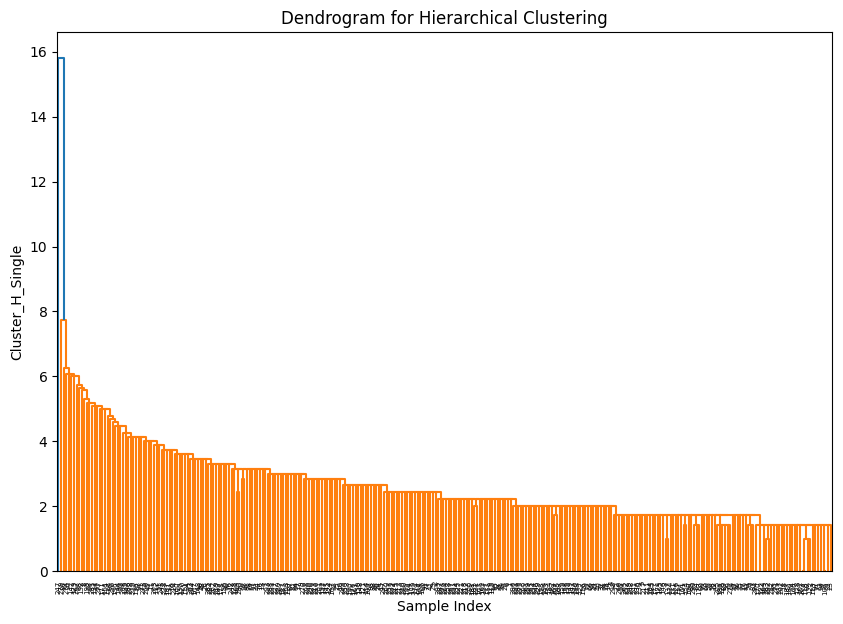

In [ ]:
bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(bow_matrix.toarray(), method='single', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Single')
plt.show()

In [ ]:
bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])
num_clusters = 4

clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='single')

df1['Cluster_H_Single'] = clustering.fit_predict(bow_matrix.toarray())

df1.head(50)

<ipython-input-83-ef1405020fd8>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete
0,watch fade,1,0,0,0,2
1,american tribe sell weed surviv,1,0,0,0,2
2,need chronic seed show grow,1,0,0,0,0
3,els watch high asf,1,0,0,0,2
4,roll joint line paper lol,1,0,0,0,2
5,stoner fli congo,1,0,0,0,2
6,song name begin video,1,0,0,0,2
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1
8,send gift make sure peopl receiv way help trib...,1,0,0,0,0
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1


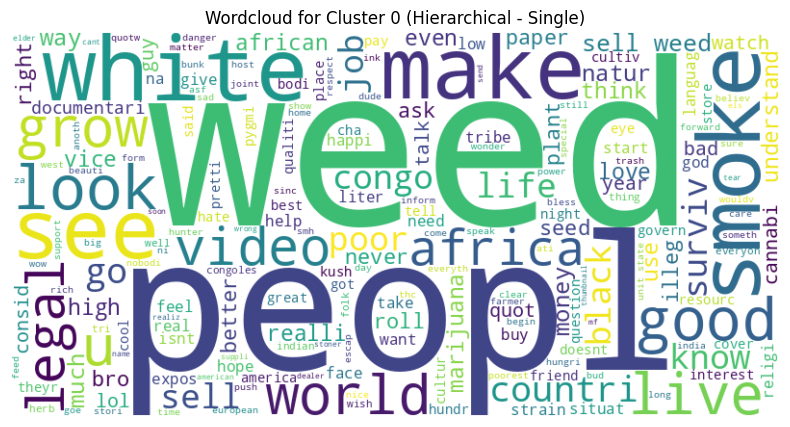

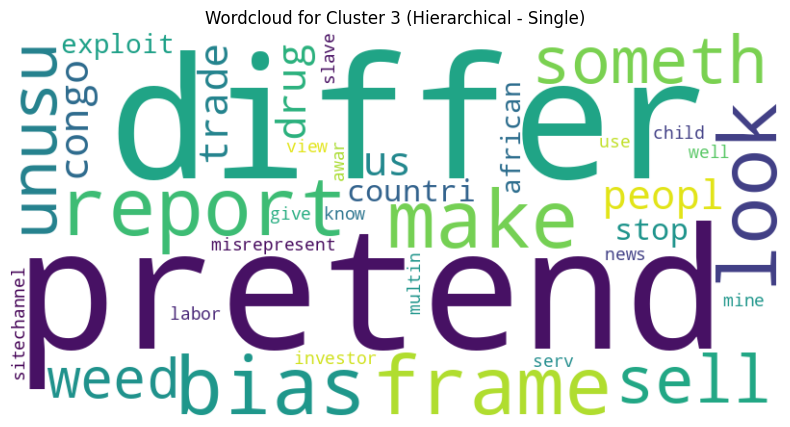

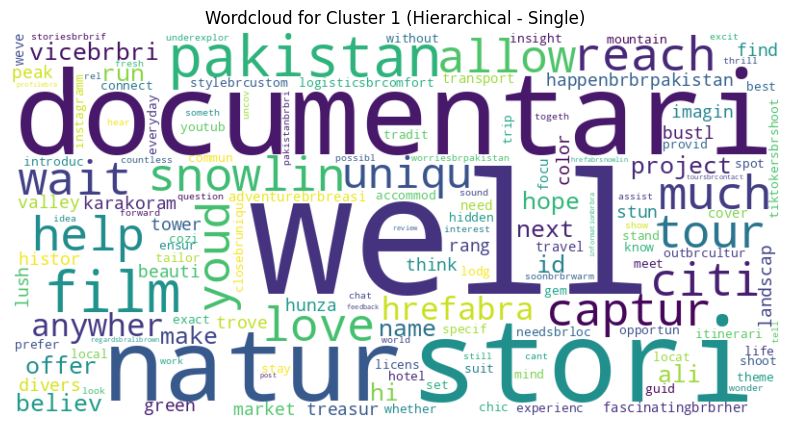

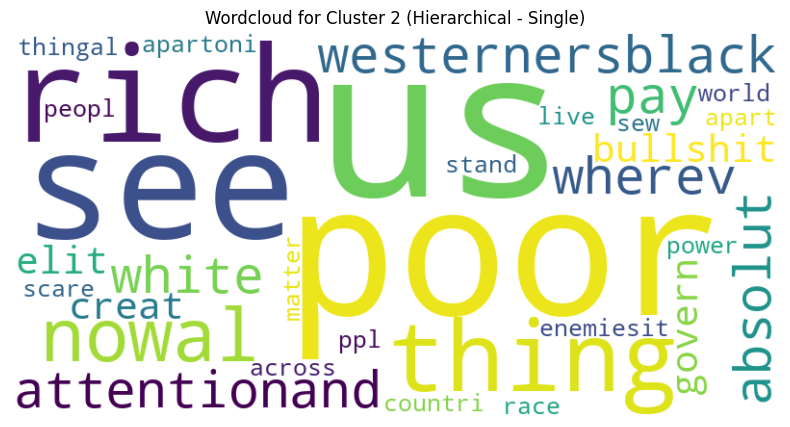

In [ ]:
for cluster in df1['Cluster_H_Single'].unique():
    text = ' '.join(df1[df1['Cluster_H_Single'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Single)')

cluster 0:
dapat disimpulkan bahwa cluster ini menjelaskan tentang kesenjangan sosial dengan kata-kata seperti poor dan world, mencerminkan perbedaan ekonomi dan perjuangan masyarakat yang kurang mampu. Komentar juga menyoroti pentingnya keadilan sosial dalam menciptakan dunia yang lebih baik.

cluster 1:
dapat disimpulkan bahwa cluster ini menjelaskan tentang film dokumenter dan cerita budaya, seperti documentari dan film. Teks mencerminkan penghargaan terhadap narasi visual dan pengaruhnya terhadap pemahaman sosial.

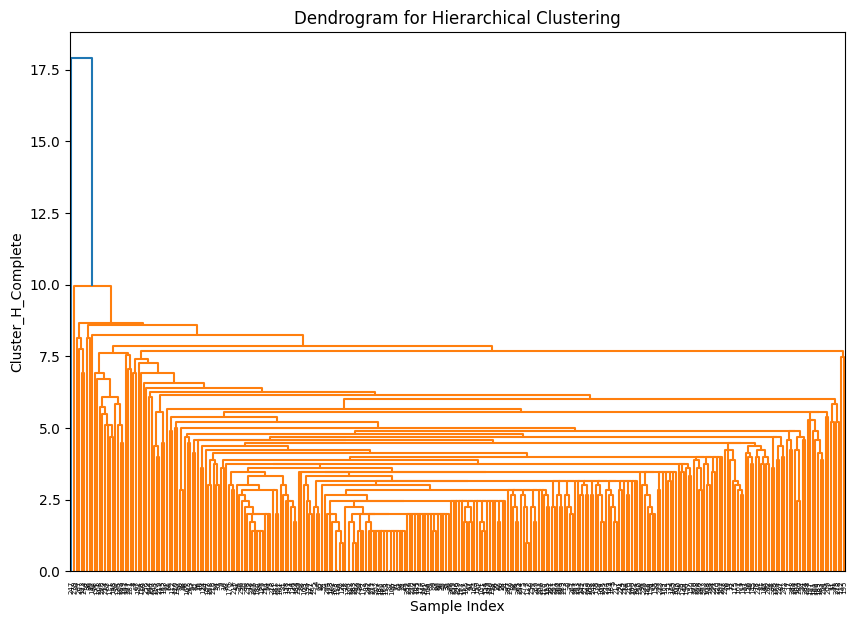

In [ ]:
bow_vectorizer = CountVectorizer()

bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(bow_matrix.toarray(), method='complete', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Complete')
plt.show()

In [ ]:
bow_matrix = bow_vectorizer.fit_transform(df1['text_stemmedSTR'])
num_clusters = 4

clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='complete')

df1['Cluster_H_Complete'] = clustering.fit_predict(tfidf_matrix.toarray())

df1.head(50)

<ipython-input-86-4f9b360fd8ae>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete
0,watch fade,1,0,0,0,2
1,american tribe sell weed surviv,1,0,0,0,2
2,need chronic seed show grow,1,0,0,0,0
3,els watch high asf,1,0,0,0,2
4,roll joint line paper lol,1,0,0,0,2
5,stoner fli congo,1,0,0,0,2
6,song name begin video,1,0,0,0,2
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1
8,send gift make sure peopl receiv way help trib...,1,0,0,0,0
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1


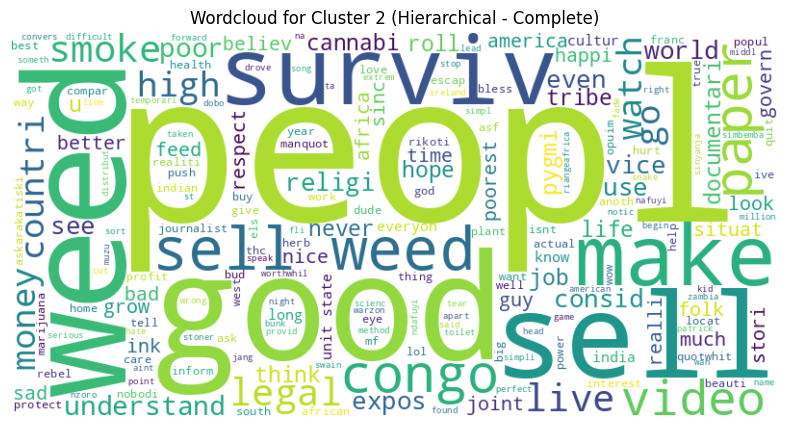

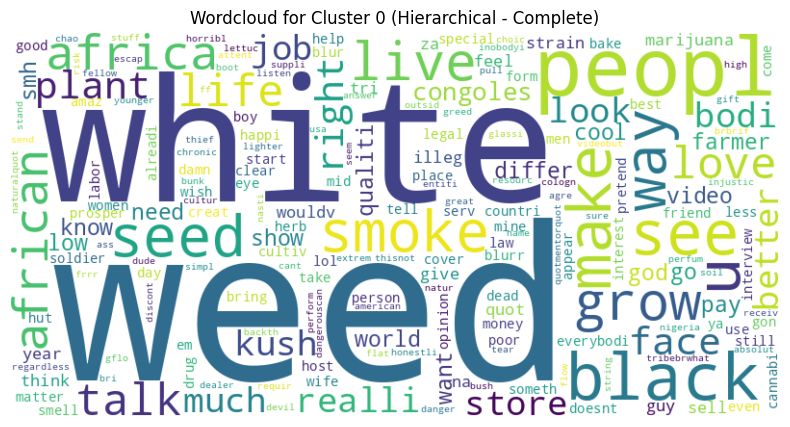

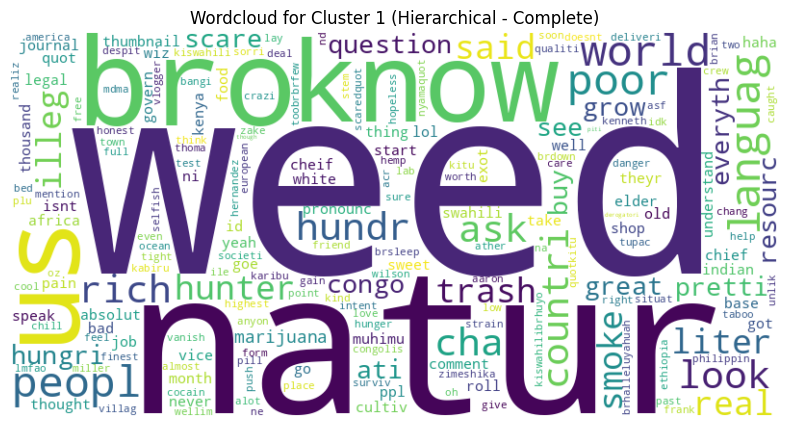

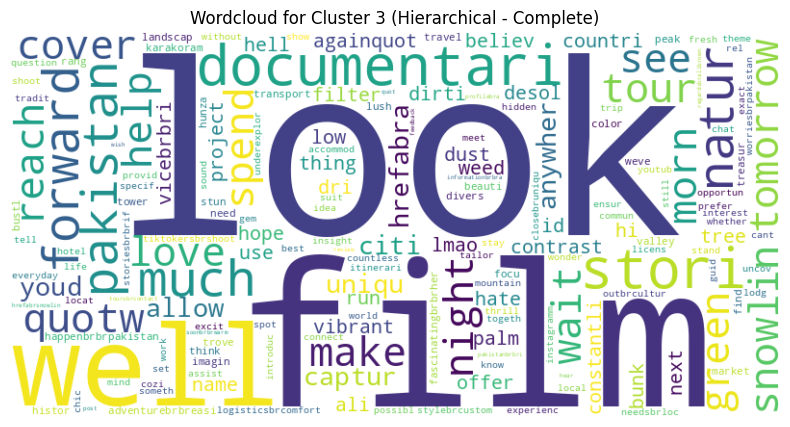

In [ ]:
for cluster in df1['Cluster_H_Complete'].unique():
    text = ' '.join(df1[df1['Cluster_H_Complete'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Complete)')

cluster 0:
dapat disimpulkan bahwa cluster ini menjelaskan tentang tantangan sosial-ekonomi global, dengan fokus pada kemiskinan dan perjuangan masyarakat di negara berkembang. Tema ini sering kali disertai seruan untuk kesetaraan dan perhatian terhadap masalah dunia.

cluster 1:
dapat disimpulkan bahwa cluster ini menjelaskan tentang aspirasi dan perjalanan hidup, dengan kata-kata seperti bless dan god. Komentar mencerminkan harapan untuk masa depan yang lebih baik melalui kerja keras dan optimisme.

In [ ]:
linkage_methods = ['single', 'complete', 'average', 'ward']

for method in linkage_methods:
  agg_clustering = AgglomerativeClustering(n_clusters=2, linkage=method, metric='euclidean')
  agg_clustering.fit(bow_matrix.toarray())

  print(f"Cluster Labels for {method} linkage:")
  labels = agg_clustering.labels_
  silhouette_avg = silhouette_score(bow_matrix.toarray(), labels)
  print(f"For {method} linkage:")
  print(f"The average silhouette_score is : {silhouette_avg}")
  print("--------------------------------------------------------------------")

Cluster Labels for single linkage:
For single linkage:
The average silhouette_score is : 0.766143151516512
--------------------------------------------------------------------
Cluster Labels for complete linkage:
For complete linkage:
The average silhouette_score is : 0.766143151516512
--------------------------------------------------------------------
Cluster Labels for average linkage:
For average linkage:
The average silhouette_score is : 0.766143151516512
--------------------------------------------------------------------
Cluster Labels for ward linkage:
For ward linkage:
The average silhouette_score is : 0.766143151516512
--------------------------------------------------------------------


#CLUSTERING WORD2VEC

##KMean

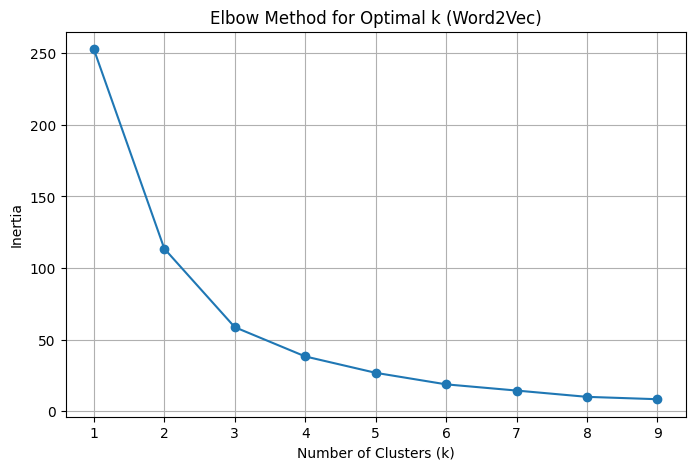

In [ ]:
# prompt: buatkan elbow metod kmean denagn word2vec

import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from gensim.models import Word2Vec

# Assuming 'model' and 'df1' are defined from the previous code
# and 'sentences' is the list of tokenized sentences

# Example usage with pre-trained Word2Vec model and example sentences:
# Assuming you have already created the model

# Convert sentences to vectors using word2vec model
vectors = []
for sentence in df1['text_stemmedSTR']:
  sentence_vector = np.zeros(model.vector_size)
  word_count = 0
  for word in sentence.split():
      if word in model.wv:
          sentence_vector += model.wv[word]
          word_count += 1
  if word_count > 0:
    vectors.append(sentence_vector / word_count)
  else:
    vectors.append(sentence_vector)

vectors = np.array(vectors)

# Elbow method
inertia = []
cluster_range = range(1, 10)  # Try different cluster ranges
for k in cluster_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(vectors)
    inertia.append(kmeans.inertia_)

# Plot the Elbow Method graph
plt.figure(figsize=(8, 5))
plt.plot(cluster_range, inertia, marker='o')
plt.title('Elbow Method for Optimal k (Word2Vec)')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.xticks(cluster_range)
plt.grid(True)
plt.show()

In [ ]:

num_clusters = 2  # Choose the optimal k based on the elbow method
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
df1['Cluster_KMeans_Word2Vec'] = kmeans.fit_predict(vectors)

<ipython-input-90-c80ba6828cc9>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Silhouette Score
silhouette_avg = silhouette_score(vectors, df1['Cluster_KMeans_Word2Vec'])
print(f"The average silhouette_score is : {silhouette_avg}")

The average silhouette_score is : 0.5049773125930218


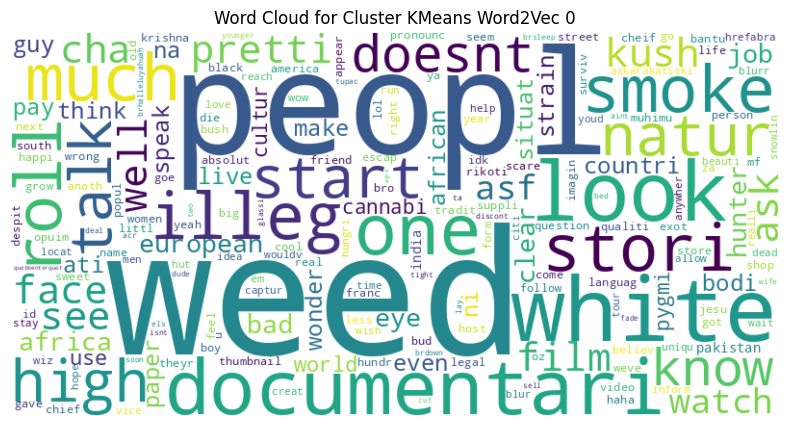

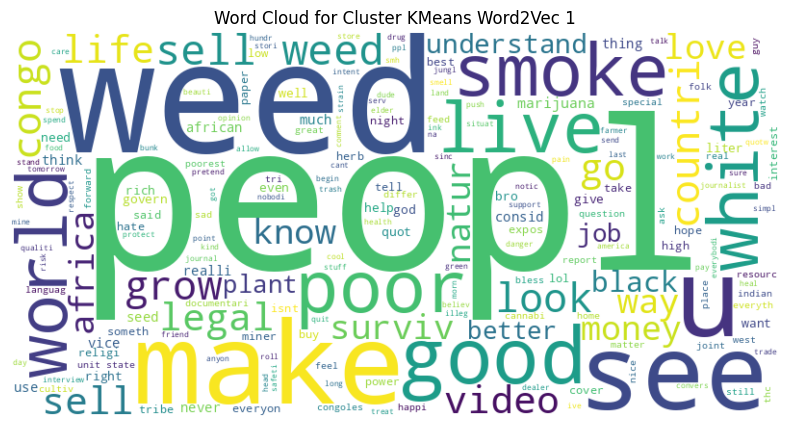

In [ ]:
# Word Clouds for each cluster
for i in range(num_clusters):
    text = " ".join(review for review in df1[df1['Cluster_KMeans_Word2Vec'] == i]['text_stemmedSTR'])
    wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Word Cloud for Cluster KMeans Word2Vec {i}")
    plt.show()

## Hierarchy clustering


<ipython-input-93-dca4bf077930>:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-93-dca4bf077930>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



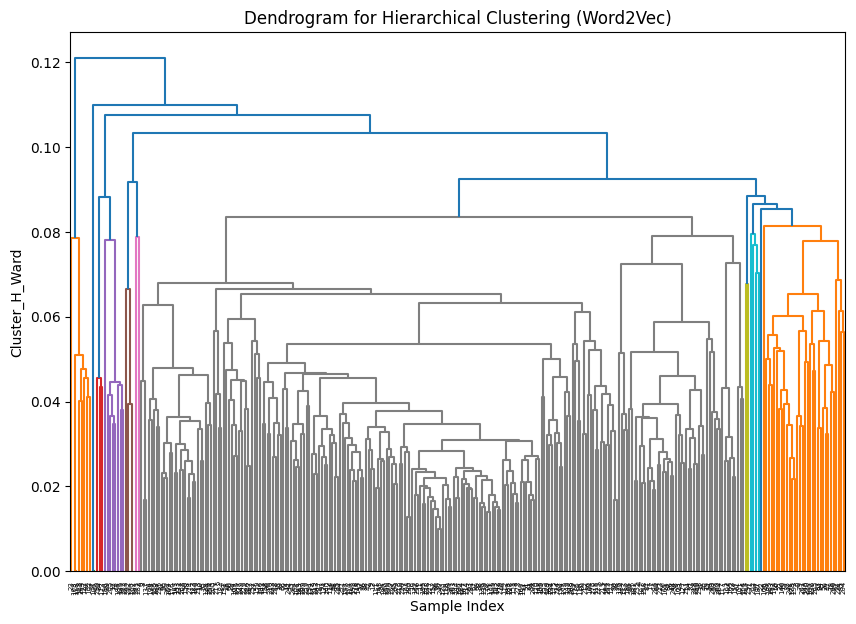

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from gensim.models import Word2Vec

df1['tokenized_text'] = df1['text_stemmedSTR'].apply(lambda x: x.split())

w2v_model = Word2Vec(sentences=df1['tokenized_text'], vector_size=100, window=5, min_count=1, workers=4)

def get_sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    if vectors:
        return sum(vectors) / len(vectors)
    else:
        return [0] * model.vector_size

df1['sentence_vector'] = df1['tokenized_text'].apply(lambda x: get_sentence_vector(x, w2v_model))

embedding_matrix = df1['sentence_vector'].tolist()

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(embedding_matrix, method='ward', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering (Word2Vec)')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Ward')
plt.show()


In [ ]:
from gensim.models import Word2Vec
from sklearn.cluster import AgglomerativeClustering

df1['tokenized_text'] = df1['text_stemmedSTR'].apply(lambda x: x.split())

w2v_model = Word2Vec(sentences=df1['tokenized_text'], vector_size=100, window=5, min_count=1, workers=4)

def get_sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    if vectors:
        return sum(vectors) / len(vectors)
    else:
        return [0] * model.vector_size

df1['sentence_vector'] = df1['tokenized_text'].apply(lambda x: get_sentence_vector(x, w2v_model))

embedding_matrix = df1['sentence_vector'].tolist()

num_clusters = 2
clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='ward')
df1['Cluster_H_Ward'] = clustering.fit_predict(embedding_matrix)
df1.head(50)


<ipython-input-94-99894ea2b3dc>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-94-99894ea2b3dc>:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-94-99894ea2b3dc>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete,Cluster_KMeans_Word2Vec,tokenized_text,sentence_vector
0,watch fade,1,0,0,0,2,0,"[watch, fade]","[0.0022835524, 0.00033287186, 0.0011769871, -0..."
1,american tribe sell weed surviv,1,0,0,0,2,1,"[american, tribe, sell, weed, surviv]","[0.0029991004, 0.0029136012, -0.0028375867, 0...."
2,need chronic seed show grow,1,0,0,0,0,1,"[need, chronic, seed, show, grow]","[-0.0019732036, -0.001204946, 0.00065984426, 0..."
3,els watch high asf,1,0,0,0,2,0,"[els, watch, high, asf]","[-0.0020629817, 0.0014327526, -0.00094563, 0.0..."
4,roll joint line paper lol,1,0,0,0,2,1,"[roll, joint, line, paper, lol]","[-0.0023967947, -0.004097976, -0.0005827992, 0..."
5,stoner fli congo,1,0,0,0,2,1,"[stoner, fli, congo]","[0.00042994742, -0.00046404204, 0.0020884157, ..."
6,song name begin video,1,0,0,0,2,1,"[song, name, begin, video]","[-0.0029584873, 0.002661371, 0.0036697024, 0.0..."
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1,0,"[illeg, weed, european, bed, lay, brdown, real...","[-0.00041389855, 0.004857209, 0.0003529567, 0...."
8,send gift make sure peopl receiv way help trib...,1,0,0,0,0,1,"[send, gift, make, sure, peopl, receiv, way, h...","[0.0011314118, 0.0039000472, 0.00038959522, -0..."
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1,1,"[elder, got, chill, realiz, ne, vice, crew, va...","[0.0019189615, -0.003114278, 0.0029523338, -0...."


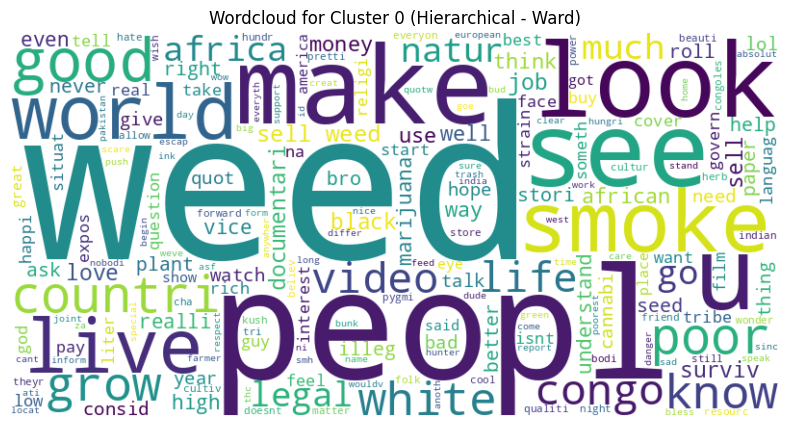

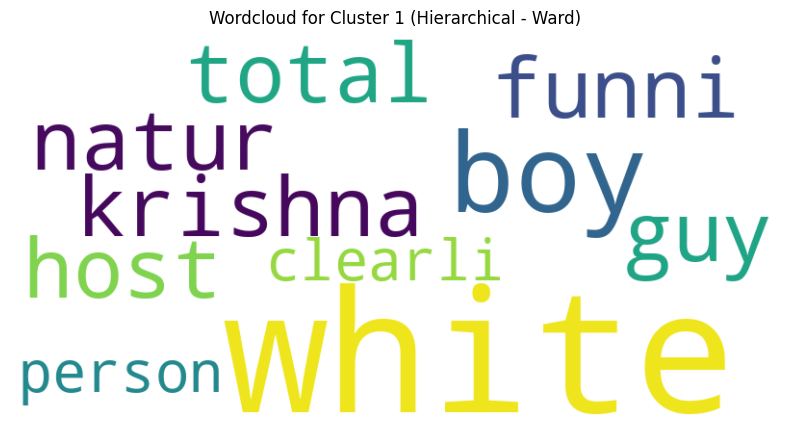

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

def plot_wordcloud(text, title):
    stop_words = set(STOPWORDS)
    stop_words.update(['famili', 'sister', 'brother', 'al', 'one', 'mijeda', 'bank', 'ok', 'faso',
                       'mijeda', 'aqsa', 'thiev', 'burkina', 'airlin', 'ga', 'car', 'amid', 'rawand',
                       'water', 'intern', 'brbr', 'miner', 'jesu', 'mali', 'okay', 'rafah', 'bu',
                       'togo', 'truck'])
    wordcloud = WordCloud(width=800, height=400, background_color='white', stopwords=stop_words).generate(text)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

for cluster in df1['Cluster_H_Ward'].unique():
    text = ' '.join(df1[df1['Cluster_H_Ward'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Ward)')


<ipython-input-96-504975ad4fb0>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-96-504975ad4fb0>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



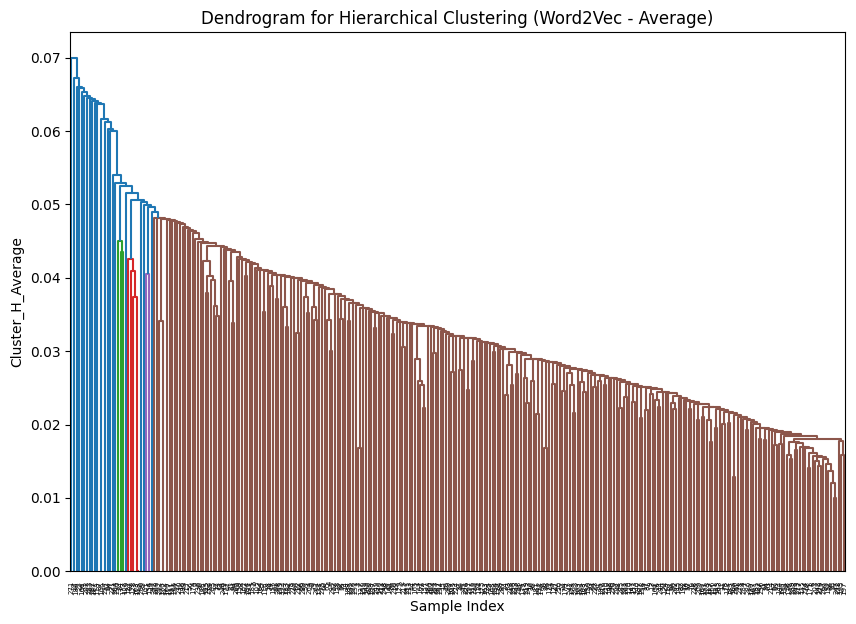

In [ ]:
from gensim.models import Word2Vec
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt

df1['tokenized_text'] = df1['text_stemmedSTR'].apply(lambda x: x.split())

w2v_model = Word2Vec(sentences=df1['tokenized_text'], vector_size=100, window=5, min_count=1, workers=4)

def get_sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    if vectors:
        return sum(vectors) / len(vectors)
    else:
        return [0] * model.vector_size

df1['sentence_vector'] = df1['tokenized_text'].apply(lambda x: get_sentence_vector(x, w2v_model))

embedding_matrix = df1['sentence_vector'].tolist()

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(embedding_matrix, method='average', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering (Word2Vec - Average)')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Average')
plt.show()


In [ ]:
from gensim.models import Word2Vec
from sklearn.cluster import AgglomerativeClustering

df1['tokenized_text'] = df1['text_stemmedSTR'].apply(lambda x: x.split())

w2v_model = Word2Vec(sentences=df1['tokenized_text'], vector_size=100, window=5, min_count=1, workers=4)

def get_sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    if vectors:
        return sum(vectors) / len(vectors)
    else:
        return [0] * model.vector_size

df1['sentence_vector'] = df1['tokenized_text'].apply(lambda x: get_sentence_vector(x, w2v_model))

embedding_matrix = df1['sentence_vector'].tolist()

num_clusters = 5
clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='average')
df1['Cluster_H_Average'] = clustering.fit_predict(embedding_matrix)

df1.head(50)


<ipython-input-97-87ee1a32a9be>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-97-87ee1a32a9be>:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-97-87ee1a32a9be>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete,Cluster_KMeans_Word2Vec,tokenized_text,sentence_vector
0,watch fade,1,0,0,0,2,0,"[watch, fade]","[0.0022835524, 0.00033287186, 0.0011769871, -0..."
1,american tribe sell weed surviv,1,0,0,0,2,1,"[american, tribe, sell, weed, surviv]","[0.0029991004, 0.0029136012, -0.0028375867, 0...."
2,need chronic seed show grow,1,0,0,0,0,1,"[need, chronic, seed, show, grow]","[-0.0019732036, -0.001204946, 0.00065984426, 0..."
3,els watch high asf,1,0,0,0,2,0,"[els, watch, high, asf]","[-0.0020629817, 0.0014327526, -0.00094563, 0.0..."
4,roll joint line paper lol,1,0,0,0,2,1,"[roll, joint, line, paper, lol]","[-0.0023967947, -0.004097976, -0.0005827992, 0..."
5,stoner fli congo,1,0,0,0,2,1,"[stoner, fli, congo]","[0.00042994742, -0.00046404204, 0.0020884157, ..."
6,song name begin video,1,0,0,0,2,1,"[song, name, begin, video]","[-0.0029584873, 0.002661371, 0.0036697024, 0.0..."
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1,0,"[illeg, weed, european, bed, lay, brdown, real...","[-0.00041389855, 0.004857209, 0.0003529567, 0...."
8,send gift make sure peopl receiv way help trib...,1,0,0,0,0,1,"[send, gift, make, sure, peopl, receiv, way, h...","[0.0011314118, 0.0039000472, 0.00038959522, -0..."
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1,1,"[elder, got, chill, realiz, ne, vice, crew, va...","[0.0019189615, -0.003114278, 0.0029523338, -0...."


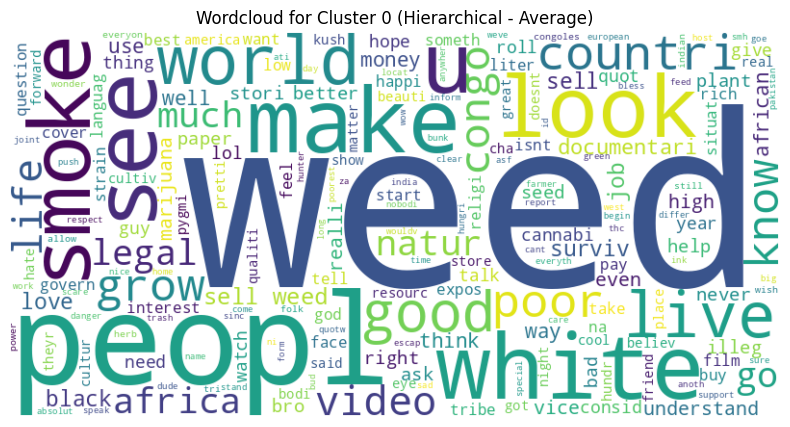

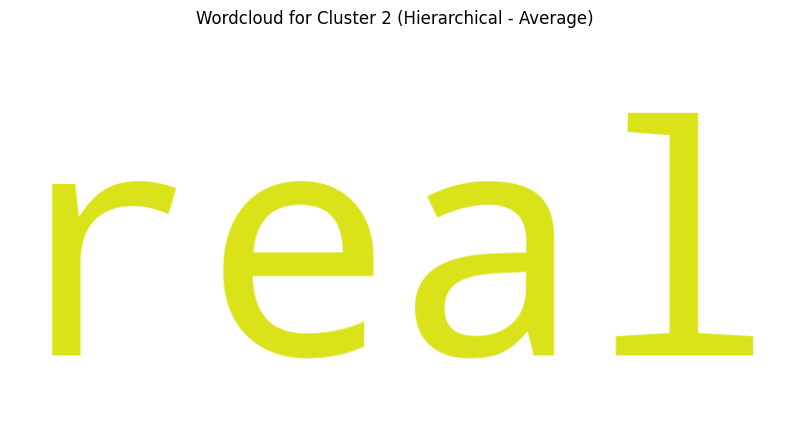

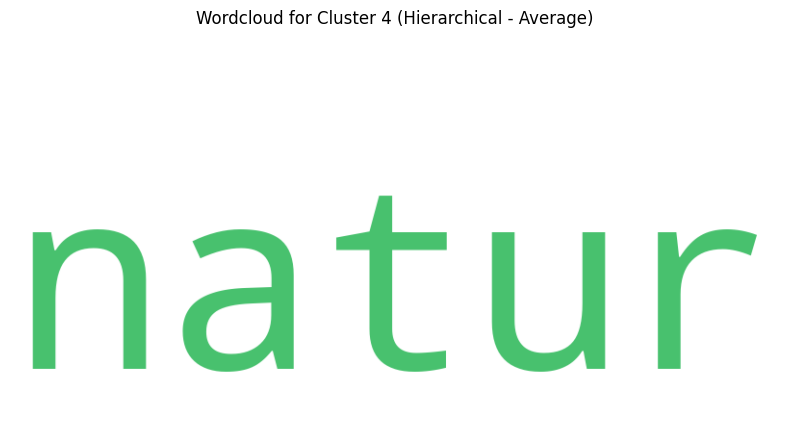

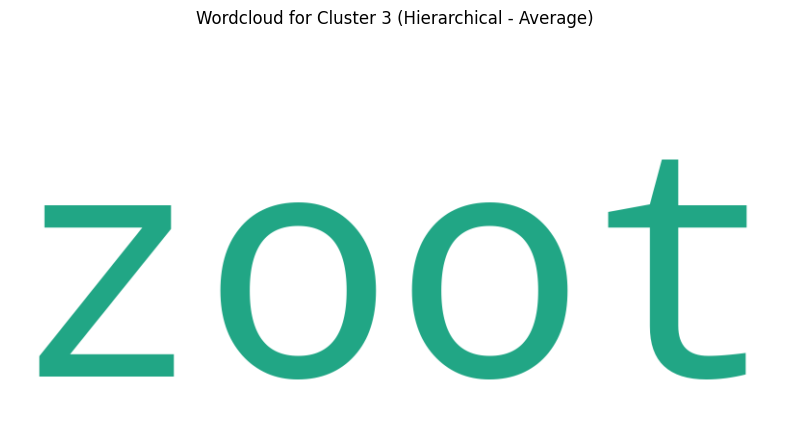

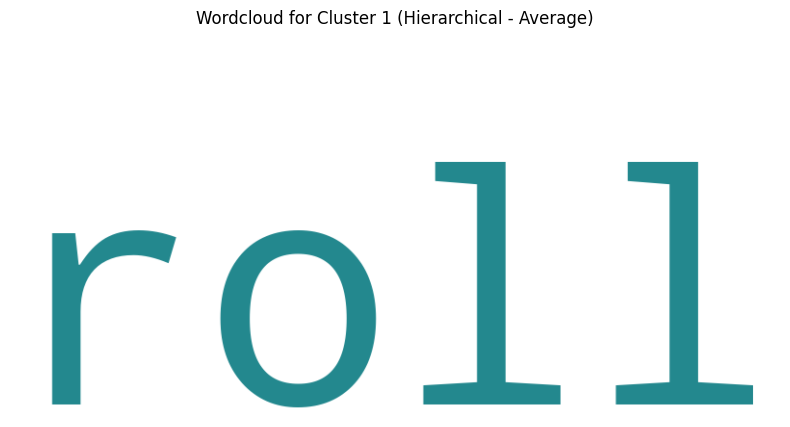

In [ ]:
for cluster in df1['Cluster_H_Average'].unique():
    text = ' '.join(df1[df1['Cluster_H_Average'] == cluster]['text_stemmedSTR'])

    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Average)')

<ipython-input-99-94e035c32ff4>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-99-94e035c32ff4>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



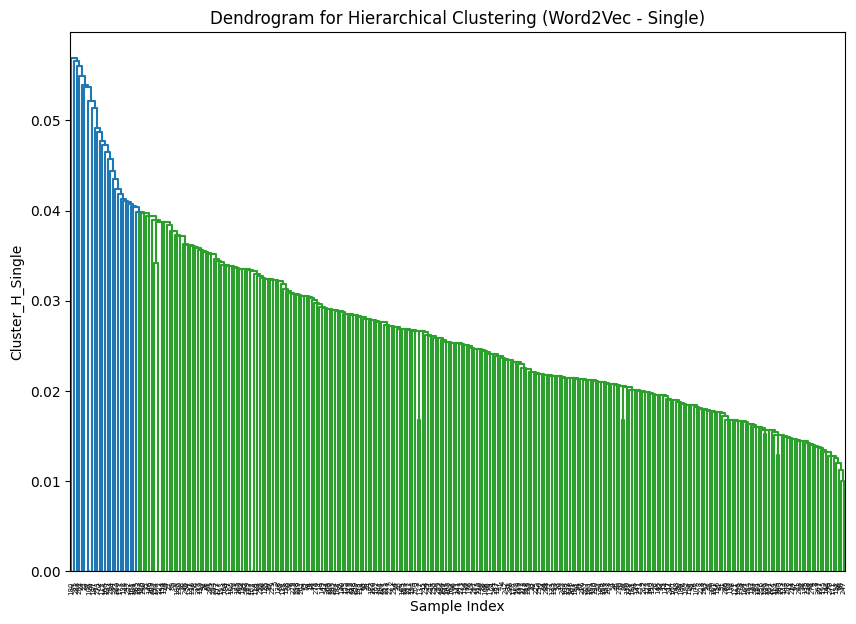

In [ ]:
from gensim.models import Word2Vec
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt

df1['tokenized_text'] = df1['text_stemmedSTR'].apply(lambda x: x.split())

w2v_model = Word2Vec(sentences=df1['tokenized_text'], vector_size=100, window=5, min_count=1, workers=4)

def get_sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    if vectors:
        return sum(vectors) / len(vectors)
    else:
        return [0] * model.vector_size

df1['sentence_vector'] = df1['tokenized_text'].apply(lambda x: get_sentence_vector(x, w2v_model))

embedding_matrix = df1['sentence_vector'].tolist()

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(embedding_matrix, method='single', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering (Word2Vec - Single)')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Single')
plt.show()


In [ ]:
from gensim.models import Word2Vec
from sklearn.cluster import AgglomerativeClustering

df1['tokenized_text'] = df1['text_stemmedSTR'].apply(lambda x: x.split())

w2v_model = Word2Vec(sentences=df1['tokenized_text'], vector_size=100, window=5, min_count=1, workers=4)

def get_sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    if vectors:
        return sum(vectors) / len(vectors)
    else:
        return [0] * model.vector_size

df1['sentence_vector'] = df1['tokenized_text'].apply(lambda x: get_sentence_vector(x, w2v_model))

embedding_matrix = df1['sentence_vector'].tolist()

num_clusters =2
clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='single')
df1['Cluster_H_Single'] = clustering.fit_predict(embedding_matrix)

df1.head(50)


<ipython-input-101-9b383006befa>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-101-9b383006befa>:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-101-9b383006befa>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete,Cluster_KMeans_Word2Vec,tokenized_text,sentence_vector
0,watch fade,1,0,0,0,2,0,"[watch, fade]","[0.0022835524, 0.00033287186, 0.0011769871, -0..."
1,american tribe sell weed surviv,1,0,0,0,2,1,"[american, tribe, sell, weed, surviv]","[0.0029991004, 0.0029136012, -0.0028375867, 0...."
2,need chronic seed show grow,1,0,0,0,0,1,"[need, chronic, seed, show, grow]","[-0.0019732036, -0.001204946, 0.00065984426, 0..."
3,els watch high asf,1,0,0,0,2,0,"[els, watch, high, asf]","[-0.0020629817, 0.0014327526, -0.00094563, 0.0..."
4,roll joint line paper lol,1,0,0,0,2,1,"[roll, joint, line, paper, lol]","[-0.0023967947, -0.004097976, -0.0005827992, 0..."
5,stoner fli congo,1,0,0,0,2,1,"[stoner, fli, congo]","[0.00042994742, -0.00046404204, 0.0020884157, ..."
6,song name begin video,1,0,0,0,2,1,"[song, name, begin, video]","[-0.0029584873, 0.002661371, 0.0036697024, 0.0..."
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1,0,"[illeg, weed, european, bed, lay, brdown, real...","[-0.00041389855, 0.004857209, 0.0003529567, 0...."
8,send gift make sure peopl receiv way help trib...,1,0,0,0,0,1,"[send, gift, make, sure, peopl, receiv, way, h...","[0.0011314118, 0.0039000472, 0.00038959522, -0..."
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1,1,"[elder, got, chill, realiz, ne, vice, crew, va...","[0.0019189615, -0.003114278, 0.0029523338, -0...."


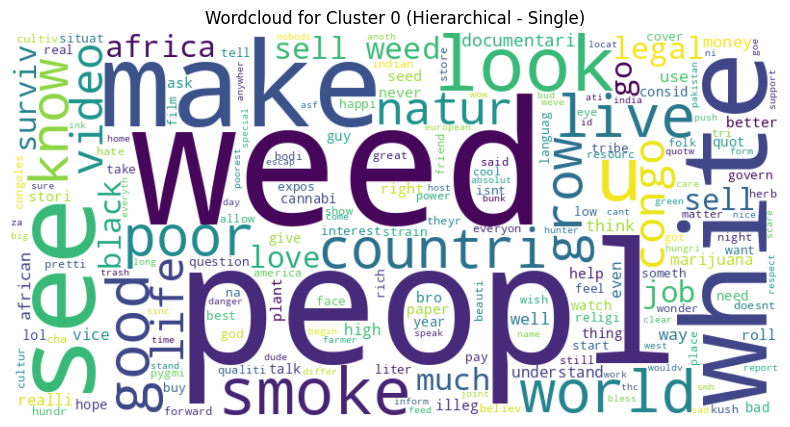

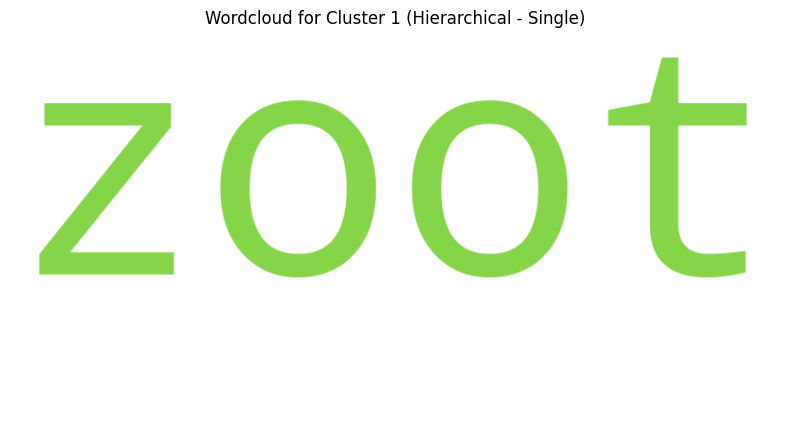

In [ ]:
for cluster in df1['Cluster_H_Single'].unique():
    text = ' '.join(df1[df1['Cluster_H_Single'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Single)')

<ipython-input-103-a2f622fa82b9>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-103-a2f622fa82b9>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



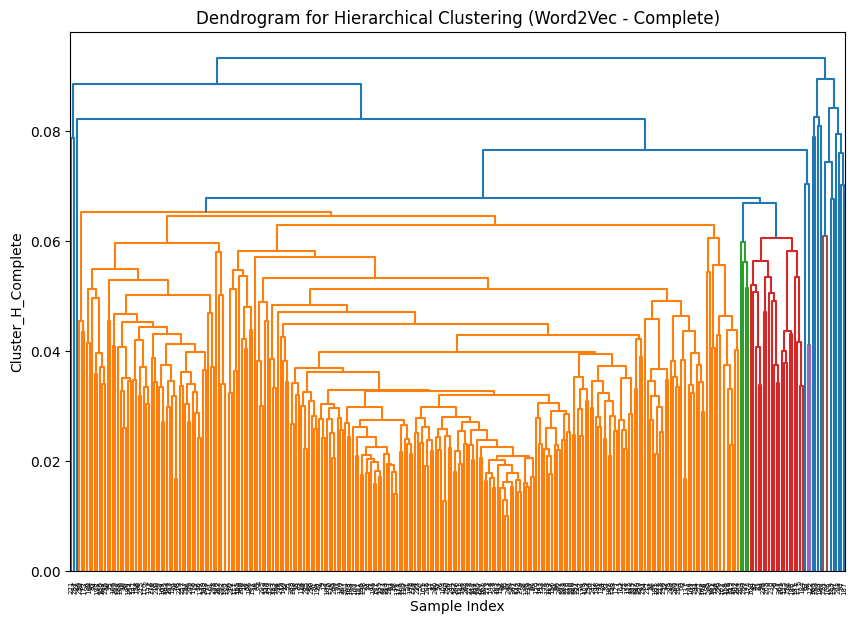

In [ ]:
from gensim.models import Word2Vec
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt

df1['tokenized_text'] = df1['text_stemmedSTR'].apply(lambda x: x.split())

w2v_model = Word2Vec(sentences=df1['tokenized_text'], vector_size=100, window=5, min_count=1, workers=4)

def get_sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    if vectors:
        return sum(vectors) / len(vectors)
    else:
        return [0] * model.vector_size

df1['sentence_vector'] = df1['tokenized_text'].apply(lambda x: get_sentence_vector(x, w2v_model))

embedding_matrix = df1['sentence_vector'].tolist()

plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(embedding_matrix, method='complete', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering (Word2Vec - Complete)')
plt.xlabel('Sample Index')
plt.ylabel('Cluster_H_Complete')
plt.show()


In [ ]:
from gensim.models import Word2Vec
from sklearn.cluster import AgglomerativeClustering

df1['tokenized_text'] = df1['text_stemmedSTR'].apply(lambda x: x.split())

w2v_model = Word2Vec(sentences=df1['tokenized_text'], vector_size=100, window=5, min_count=1, workers=4)

def get_sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    if vectors:
        return sum(vectors) / len(vectors)
    else:
        return [0] * model.vector_size

df1['sentence_vector'] = df1['tokenized_text'].apply(lambda x: get_sentence_vector(x, w2v_model))

embedding_matrix = df1['sentence_vector'].tolist()

num_clusters = 2
clustering = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='complete')
df1['Cluster_H_Complete'] = clustering.fit_predict(embedding_matrix)

df1.head(50)


<ipython-input-104-f37f9ec5ac3a>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-104-f37f9ec5ac3a>:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-104-f37f9ec5ac3a>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text_stemmedSTR,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Single,Cluster_H_Complete,Cluster_KMeans_Word2Vec,tokenized_text,sentence_vector
0,watch fade,1,0,0,0,1,0,"[watch, fade]","[0.0022835524, 0.00033287186, 0.0011769871, -0..."
1,american tribe sell weed surviv,1,0,0,0,1,1,"[american, tribe, sell, weed, surviv]","[0.0029991004, 0.0029136012, -0.0028375867, 0...."
2,need chronic seed show grow,1,0,0,0,1,1,"[need, chronic, seed, show, grow]","[-0.0019732036, -0.001204946, 0.00065984426, 0..."
3,els watch high asf,1,0,0,0,1,0,"[els, watch, high, asf]","[-0.0020629817, 0.0014327526, -0.00094563, 0.0..."
4,roll joint line paper lol,1,0,0,0,1,1,"[roll, joint, line, paper, lol]","[-0.0023967947, -0.004097976, -0.0005827992, 0..."
5,stoner fli congo,1,0,0,0,1,1,"[stoner, fli, congo]","[0.00042994742, -0.00046404204, 0.0020884157, ..."
6,song name begin video,1,0,0,0,1,1,"[song, name, begin, video]","[-0.0029584873, 0.002661371, 0.0036697024, 0.0..."
7,illeg weed european bed lay brdown real soon b...,1,0,0,0,1,0,"[illeg, weed, european, bed, lay, brdown, real...","[-0.00041389855, 0.004857209, 0.0003529567, 0...."
8,send gift make sure peopl receiv way help trib...,1,0,0,0,1,1,"[send, gift, make, sure, peopl, receiv, way, h...","[0.0011314118, 0.0039000472, 0.00038959522, -0..."
9,elder got chill realiz ne vice crew vanish,1,0,0,0,1,1,"[elder, got, chill, realiz, ne, vice, crew, va...","[0.0019189615, -0.003114278, 0.0029523338, -0...."


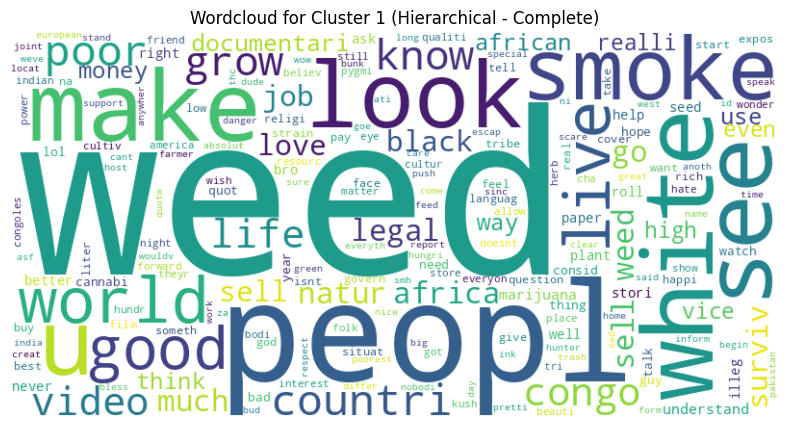

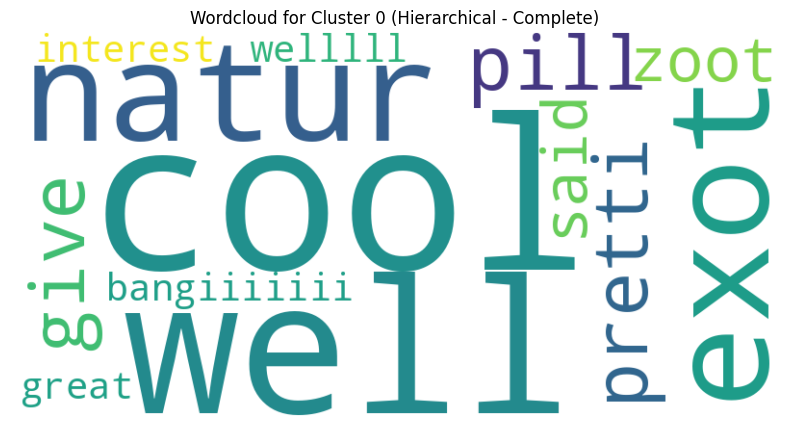

In [ ]:
for cluster in df1['Cluster_H_Complete'].unique():
    text = ' '.join(df1[df1['Cluster_H_Complete'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Complete)')

In [ ]:
# prompt: perbadndingan setiap silhoutte scor dalam tiap metode

# Calculate and print silhouette scores for each clustering method
methods = ['Cluster_H_Average', 'Cluster_H_Single', 'Cluster_H_Complete', 'Cluster_KMeans_Word2Vec', 'Cluster_H_Ward']
for method in methods:
    try:
        silhouette_avg = silhouette_score(bow_matrix.toarray(), df1[method]) if method.startswith('Cluster_H') else silhouette_score(vectors, df1[method])
        print(f"Silhouette score for {method}: {silhouette_avg}")
    except KeyError:
        print(f"Silhouette score cannot be calculated for {method} because the clustering method was not found or the data is not available.")
    except ValueError: # handles cases with only one cluster
        print(f"Silhouette score cannot be calculated for {method} because number of labels is 1.")

Silhouette score for Cluster_H_Average: -0.2931449554197666
Silhouette score for Cluster_H_Single: -0.2913071846678308
Silhouette score for Cluster_H_Complete: -0.24518135314845324
Silhouette score for Cluster_KMeans_Word2Vec: 0.5049773125930218
Silhouette score for Cluster_H_Ward: -0.21639511333602238


In [ ]:
df1.to_csv('YouTube2_Cluster.csv', index=False)

# CLUSTERING DENGAN FAST TEXT

##KMEANS

In [ ]:
import fasttext
from gensim.models import FastText
import numpy as np
import pandas as pd

sentences = data_clean_cln['text_stemmedSTR'].dropna().apply(lambda x: x.split()).tolist()
model = FastText(sentences, vector_size=100, window=5, min_count=1, workers=4)

df2 = data_clean_cln[['text_stemmedSTR']]
df1 = df2[:300]
df1['embedding'] = df1['text_stemmedSTR'].apply(lambda x: model.wv.get_mean_vector(x.split()))

<ipython-input-108-f930c4c75be8>:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



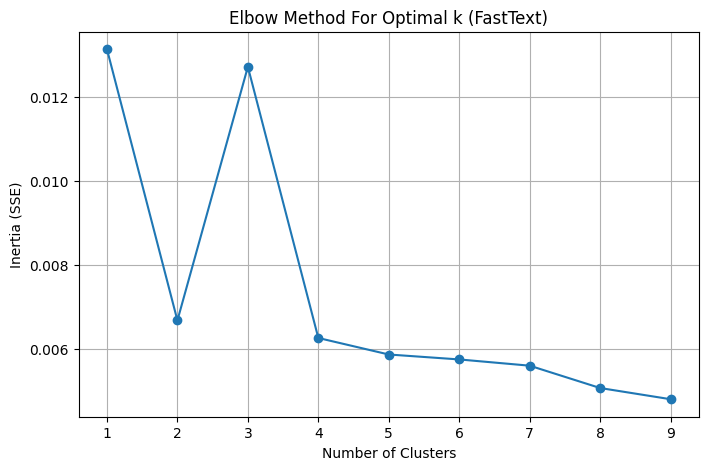

In [ ]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

embeddings = np.vstack(df1['embedding'].to_numpy())

inertia = []
cluster_range = range(1, 10)

for k in cluster_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(embeddings)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(cluster_range, inertia, marker='o')
plt.title('Elbow Method For Optimal k (FastText)')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia (SSE)')
plt.xticks(cluster_range)
plt.grid(True)
plt.show()

<ipython-input-110-2011636490cb>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



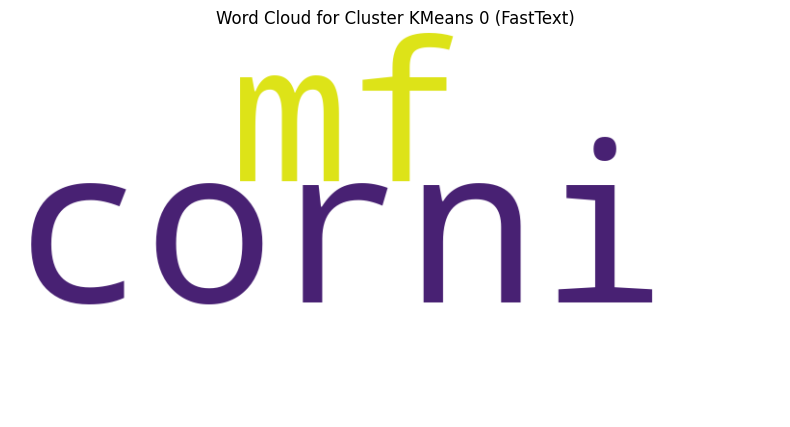

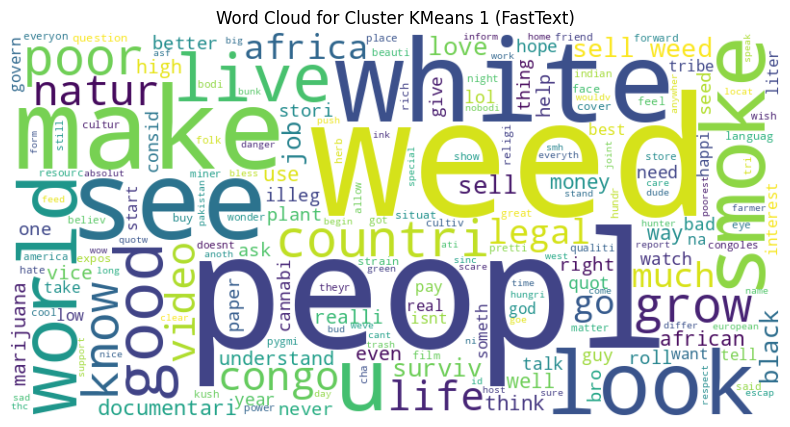

In [ ]:
from wordcloud import WordCloud

# Tentukan jumlah cluster optimal
num_clusters = 2
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
df1['Cluster_KMeans'] = kmeans.fit_predict(embeddings)

# Visualisasi WordCloud untuk setiap cluster
for i in range(num_clusters):
    text = " ".join(review for review in df1[df1['Cluster_KMeans'] == i]['text_stemmedSTR'])
    wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Word Cloud for Cluster KMeans {i} (FastText)")
    plt.show()


##HIERARCHICAL

In [ ]:
from gensim.models import FastText
import numpy as np
import pandas as pd

# Memastikan kolom tersedia dan menghapus nilai NaN
df1 = df1.dropna(subset=['text_stemmedSTR'])

# Membuat model FastText
sentences = df1['text_stemmedSTR'].apply(lambda x: x.split()).tolist()
model = FastText(sentences, vector_size=100, window=5, min_count=1, workers=4)

# Mendapatkan embedding untuk setiap dokumen
df1['embedding'] = df1['text_stemmedSTR'].apply(lambda x: model.wv.get_mean_vector(x.split()))
embeddings = np.vstack(df1['embedding'].to_numpy())

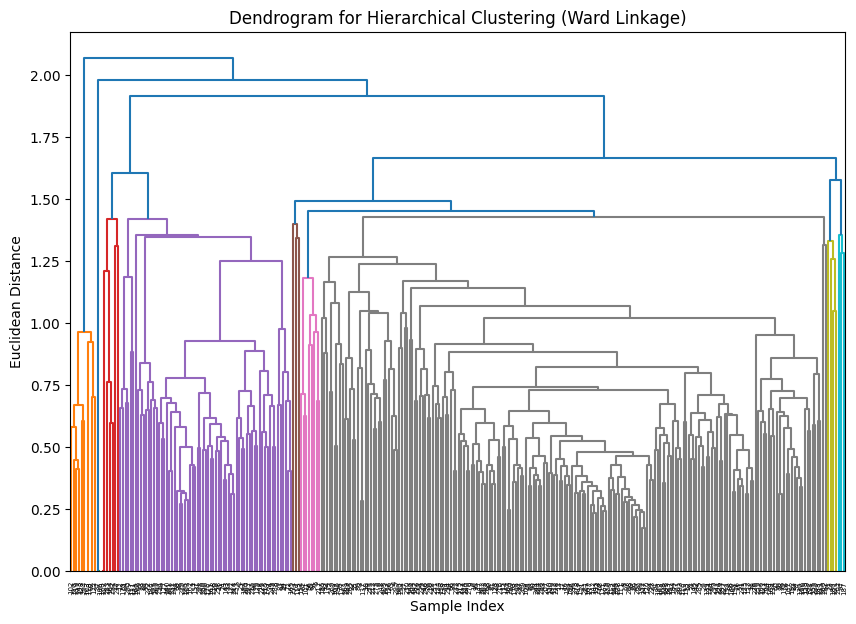

In [ ]:
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as sch

# Membuat dendrogram (Ward Linkage)
plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(embeddings, method='ward', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering (Ward Linkage)')
plt.xlabel('Sample Index')
plt.ylabel('Euclidean Distance')
plt.show()


In [ ]:
from sklearn.cluster import AgglomerativeClustering

# Clustering menggunakan Ward Linkage
num_clusters = 2
clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='ward', metric='euclidean')
df1['Cluster_H_Ward'] = clustering.fit_predict(embeddings)

df1.head(50)


,text_stemmedSTR,embedding,Cluster_KMeans,Cluster_H_Ward
0,watch fade,"[0.08703114, -0.103049755, -0.108972445, -0.04...",1,0
1,american tribe sell weed surviv,"[0.037345745, 0.062906556, -0.046286494, 0.035...",1,0
2,need chronic seed show grow,"[0.044477772, -0.008894524, -0.019260895, 0.04...",1,0
3,els watch high asf,"[0.037539553, -0.052397437, 0.030340195, 0.047...",1,0
4,roll joint line paper lol,"[-0.08226576, -0.017712727, 0.07552995, -0.006...",1,0
5,stoner fli congo,"[0.04315344, 0.0047477633, 0.01466209, 0.09223...",1,0
6,song name begin video,"[-0.088404365, -0.049023107, 0.050436825, -0.0...",1,0
7,illeg weed european bed lay brdown real soon b...,"[0.011610764, 0.05059465, -0.021397157, -0.070...",1,0
8,send gift make sure peopl receiv way help trib...,"[-0.0032978242, -0.0047686724, 0.027404997, -0...",1,0
9,elder got chill realiz ne vice crew vanish,"[0.0031007435, 0.012394698, -0.003316652, -0.0...",1,0


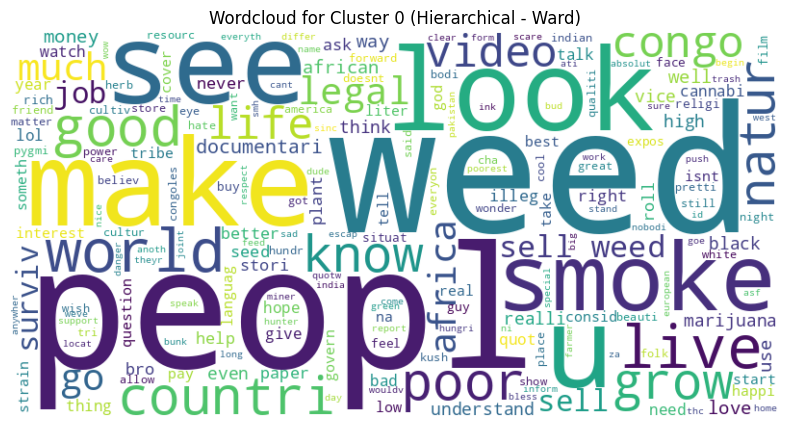

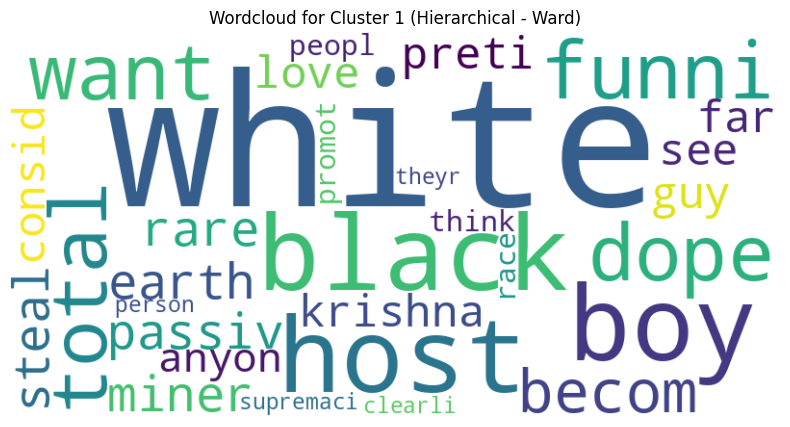

In [ ]:
from wordcloud import WordCloud, STOPWORDS

# Fungsi untuk membuat WordCloud
def plot_wordcloud(text, title):
    stop_words = set(STOPWORDS)
    stop_words.update(['famili', 'sister', 'brother', 'al', 'one'])
    wordcloud = WordCloud(width=800, height=400, background_color='white', stopwords=stop_words).generate(text)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

# Membuat WordCloud untuk setiap cluster
for cluster in df1['Cluster_H_Ward'].unique():
    text = ' '.join(df1[df1['Cluster_H_Ward'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Ward)')


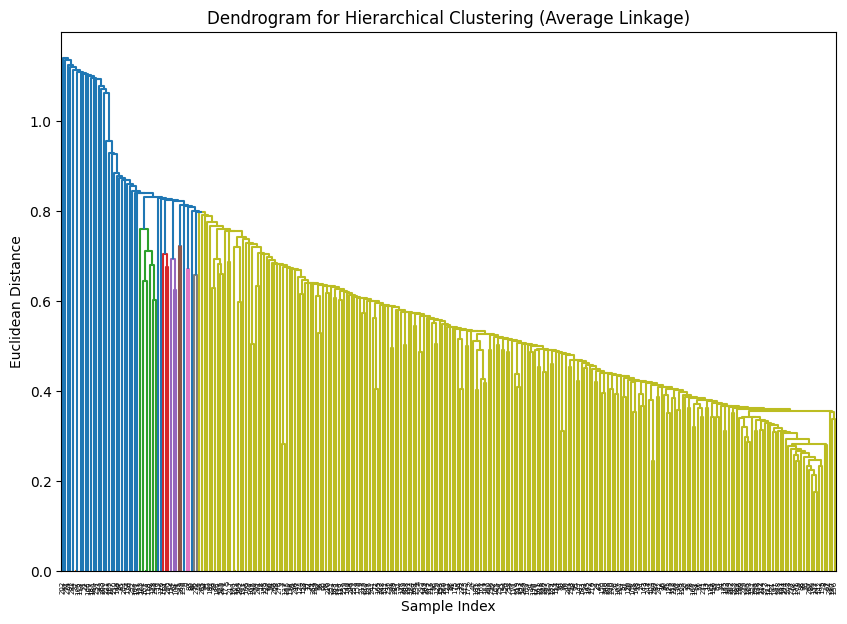

In [ ]:
plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(embeddings, method='average', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering (Average Linkage)')
plt.xlabel('Sample Index')
plt.ylabel('Euclidean Distance')
plt.show()


In [ ]:
clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average', metric='euclidean')
df1['Cluster_H_Average'] = clustering.fit_predict(embeddings)

df1.head(50)


,text_stemmedSTR,embedding,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average
0,watch fade,"[0.08703114, -0.103049755, -0.108972445, -0.04...",1,0,0
1,american tribe sell weed surviv,"[0.037345745, 0.062906556, -0.046286494, 0.035...",1,0,0
2,need chronic seed show grow,"[0.044477772, -0.008894524, -0.019260895, 0.04...",1,0,0
3,els watch high asf,"[0.037539553, -0.052397437, 0.030340195, 0.047...",1,0,0
4,roll joint line paper lol,"[-0.08226576, -0.017712727, 0.07552995, -0.006...",1,0,0
5,stoner fli congo,"[0.04315344, 0.0047477633, 0.01466209, 0.09223...",1,0,0
6,song name begin video,"[-0.088404365, -0.049023107, 0.050436825, -0.0...",1,0,0
7,illeg weed european bed lay brdown real soon b...,"[0.011610764, 0.05059465, -0.021397157, -0.070...",1,0,0
8,send gift make sure peopl receiv way help trib...,"[-0.0032978242, -0.0047686724, 0.027404997, -0...",1,0,0
9,elder got chill realiz ne vice crew vanish,"[0.0031007435, 0.012394698, -0.003316652, -0.0...",1,0,0


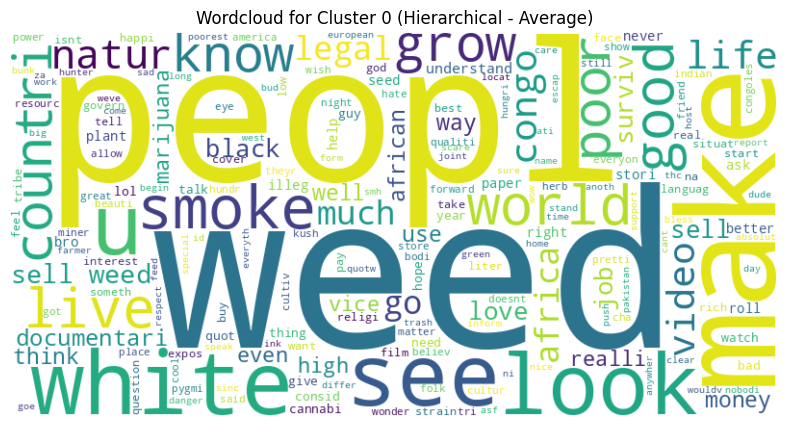

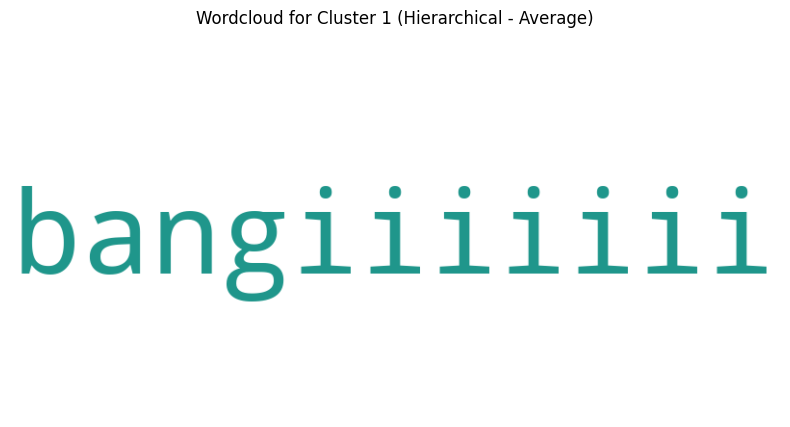

In [ ]:
for cluster in df1['Cluster_H_Average'].unique():
    text = ' '.join(df1[df1['Cluster_H_Average'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Average)')


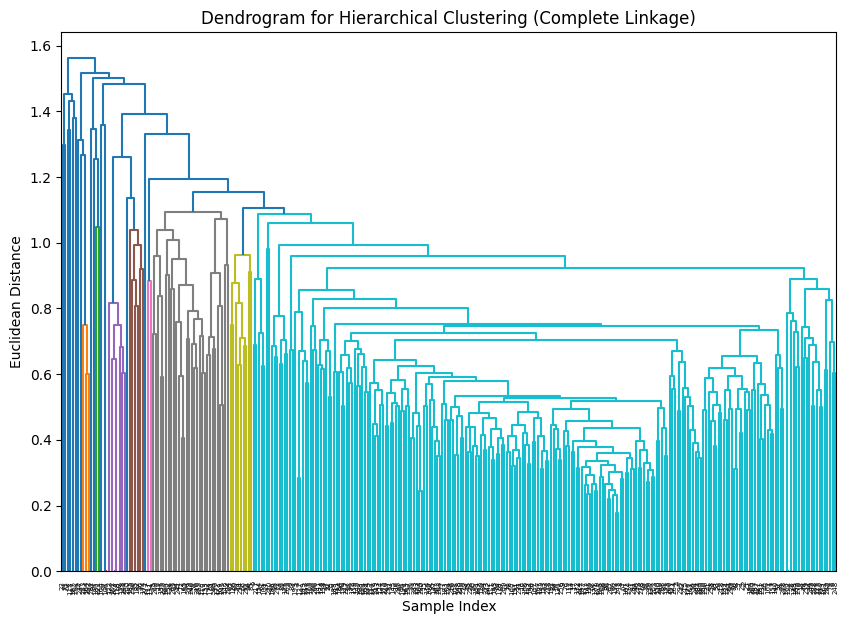

In [ ]:
plt.figure(figsize=(10, 7))
sch.dendrogram(sch.linkage(embeddings, method='complete', metric='euclidean'))
plt.title('Dendrogram for Hierarchical Clustering (Complete Linkage)')
plt.xlabel('Sample Index')
plt.ylabel('Euclidean Distance')
plt.show()


In [ ]:
clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='complete', metric='euclidean')
df1['Cluster_H_Complete'] = clustering.fit_predict(embeddings)

df1.head(50)


,text_stemmedSTR,embedding,Cluster_KMeans,Cluster_H_Ward,Cluster_H_Average,Cluster_H_Complete
0,watch fade,"[0.08703114, -0.103049755, -0.108972445, -0.04...",1,0,0,0
1,american tribe sell weed surviv,"[0.037345745, 0.062906556, -0.046286494, 0.035...",1,0,0,0
2,need chronic seed show grow,"[0.044477772, -0.008894524, -0.019260895, 0.04...",1,0,0,0
3,els watch high asf,"[0.037539553, -0.052397437, 0.030340195, 0.047...",1,0,0,0
4,roll joint line paper lol,"[-0.08226576, -0.017712727, 0.07552995, -0.006...",1,0,0,0
5,stoner fli congo,"[0.04315344, 0.0047477633, 0.01466209, 0.09223...",1,0,0,0
6,song name begin video,"[-0.088404365, -0.049023107, 0.050436825, -0.0...",1,0,0,0
7,illeg weed european bed lay brdown real soon b...,"[0.011610764, 0.05059465, -0.021397157, -0.070...",1,0,0,0
8,send gift make sure peopl receiv way help trib...,"[-0.0032978242, -0.0047686724, 0.027404997, -0...",1,0,0,0
9,elder got chill realiz ne vice crew vanish,"[0.0031007435, 0.012394698, -0.003316652, -0.0...",1,0,0,0


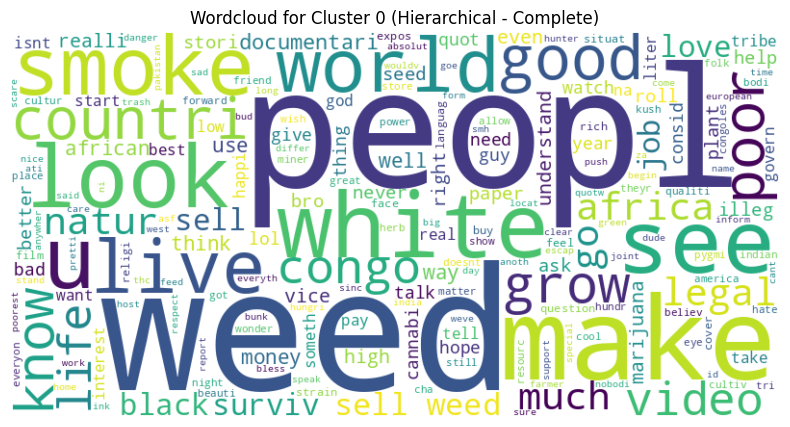

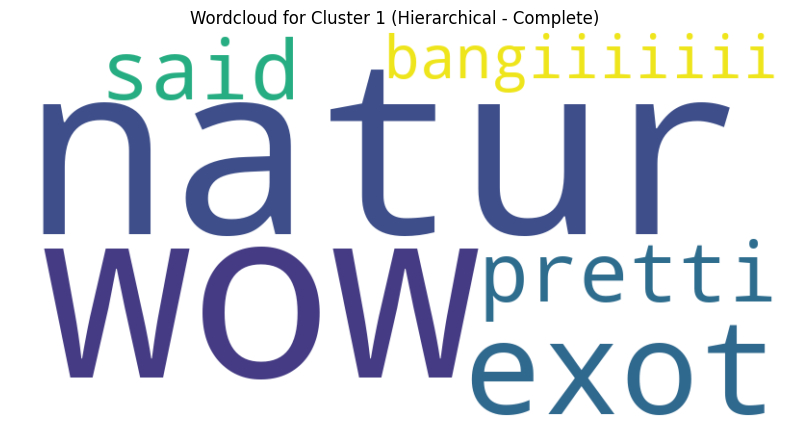

In [ ]:
for cluster in df1['Cluster_H_Complete'].unique():
    text = ' '.join(df1[df1['Cluster_H_Complete'] == cluster]['text_stemmedSTR'])
    plot_wordcloud(text, f'Wordcloud for Cluster {cluster} (Hierarchical - Complete)')


In [ ]:
from sklearn.metrics import silhouette_score

linkage_methods = ['single', 'complete', 'average', 'ward']

for method in linkage_methods:
    clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage=method, metric='euclidean')
    clustering.fit(embeddings)
    labels = clustering.labels_
    silhouette_avg = silhouette_score(embeddings, labels)
    print(f"Silhouette Score for {method} linkage: {silhouette_avg}")
    print("--------------------------------------------------------------------")


Silhouette Score for single linkage: 0.38203686475753784
--------------------------------------------------------------------
Silhouette Score for complete linkage: 0.3816177248954773
--------------------------------------------------------------------
Silhouette Score for average linkage: 0.3944202661514282
--------------------------------------------------------------------
Silhouette Score for ward linkage: 0.13746465742588043
--------------------------------------------------------------------


In [ ]:
df1.to_csv('FastText_Cluster.csv', index=False)
